In [ ]:
#Import functions and libraries from scripts
from GP_funcs import *
from file_opening import *
from SCB_conversion import SCB_CONVERSION

import string

#for plotting
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

from matplotlib.lines import Line2D
from matplotlib.patches import Patch
from matplotlib.legend_handler import HandlerTuple

from pathlib import Path
import time
from datetime import timedelta

# for exporting things as mat for matlab
import scipy.io

# For linear regression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


# For kernel covariance matrix
import seaborn as sns

from sklearn.model_selection import KFold, GridSearchCV
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ConstantKernel, DotProduct, RationalQuadratic, Matern
import numpy as np
import math

import warnings
from sklearn.exceptions import UndefinedMetricWarning, ConvergenceWarning

In [32]:
'''User set values for code blocks to run '''
p = 100 #number of points wanted for GP's
colr_sc = ['#E37A1B','#FFD966','#8EB85A','#A3E8F3','#376C72','#9F8BAD',"#ED9CCB", "#615C3B",'#FF9840',"#9F755F"] #Color scheme
markers = ['s', 'o','^', '*', 'X','>','d','<','v','+']
labels = list(string.ascii_uppercase)

x_key = 'ABS'
y_key = 'SSC'

MATLAB_FILEPATH = "GVR_LISST"


plt.rcParams.update({'font.size': 12})

# create_USGS_dfs('sensor', USGS_site_id) 

# Load USGS data

In [3]:
import glob

lisst_dir = "LISST_ABS_USGS"
lisst_files = glob.glob(f"{lisst_dir}/*.csv")
print(f"📁 Found {len(lisst_files)} CSV files")
alpha_site_id = labels[0:len(lisst_files)]

lisst_data_dict = {}

# Prioritized variants for each column
column_priority = {
    "ABS": ["ABS (All)", "ABS"],
    "Turb": ["Turb (All)", "Turbidity"],  # ← optional now
    "SSC": ["SSC (All)", "Total SSC"],
    "Fines": ["Fines"],
    "Sands": ["Sands"],
    "Date": ["Date"]
}

for i, file_path in enumerate(lisst_files):
    fname = file_path.split("/")[-1]
    site_id = fname.replace(".csv", "")
    print(f"\n📄 Processing: {fname}")

    try:
        # Step 1: Read only column headers
        df_head = pd.read_csv(file_path, nrows=0)
        file_cols = df_head.columns.tolist()
        print(f"🔍 Columns found: {file_cols}")

        # Step 2: Select available columns
        selected_cols = {}
        for std_name, variants in column_priority.items():
            for variant in variants:
                if variant in file_cols:
                    selected_cols[variant] = std_name
                    break  # take the first available option

        # Step 3: Check for required columns (excluding Turb)
        required_columns = {"Date", "ABS", "SSC", "Fines", "Sands"}
        found_columns = set(selected_cols.values())

        if not required_columns.issubset(found_columns):
            print(f"⚠️ Skipping {fname}: Missing required columns → {required_columns - found_columns}")
            continue

        # Step 4: Read available columns
        df = pd.read_csv(file_path, usecols=selected_cols.keys())

        # Step 5: Rename to consistent names
        df = df.rename(columns=selected_cols)

        # Step 6: If Turb missing, add column with NaNs
        if "Turb" not in df.columns:
            df["Turb"] = np.nan
            print(f"ℹ️ Note: 'Turb' not found in {fname}, filled with NaN.")

        # Step 7: Store in dictionary
        lisst_data_dict[alpha_site_id[i]] = {'site_id': site_id,
                                             'datetime': df["Date"],
                                             'ABS': df["ABS"],
                                             "SSC": df["SSC"],
                                             'fines': df["Fines"],
                                             'sands': df["Sands"],
                                             'turb': df['Turb']}
        print(f"✅ Loaded {fname} with {len(df)} rows")

    except Exception as e:
        print(f"❌ Error reading {fname}: {type(e).__name__} — {e}")


📁 Found 7 CSV files

📄 Processing: Missouri_River_NebraskaCity_06807000.csv
🔍 Columns found: ['Date', 'Depth', 'ABS', 'Turbidity', 'Total SSC', 'Percent Finer', 'Fines', 'Sands']
✅ Loaded Missouri_River_NebraskaCity_06807000.csv with 25 rows

📄 Processing: Rock_Creek_01648010.csv
🔍 Columns found: ['Date', 'ABS', 'Turbidity', 'Total SSC', 'Fines', 'Sands']
✅ Loaded Rock_Creek_01648010.csv with 68 rows

📄 Processing: Elwha_River_12046260.csv
🔍 Columns found: ['Date', 'ABS', 'ABS (All)', 'Turbidity', 'Turb (All)', 'Total SSC', 'SSC (All)', 'Fines', 'Sands']
✅ Loaded Elwha_River_12046260.csv with 73 rows

📄 Processing: Sacramento_River_11447650.csv
🔍 Columns found: ['Date', 'Depth', 'ABS', 'Turbidity', 'Total SSC', 'Percent Finer', 'Fines', 'Sands']
✅ Loaded Sacramento_River_11447650.csv with 22 rows

📄 Processing: Illinois_River_05586300.csv
🔍 Columns found: ['Date', 'Depth', 'ABS', 'Turbidity', 'Total SSC', 'Percent Finer', 'Fines', 'Sands']
✅ Loaded Illinois_River_05586300.csv with 25 r

# Linear fits

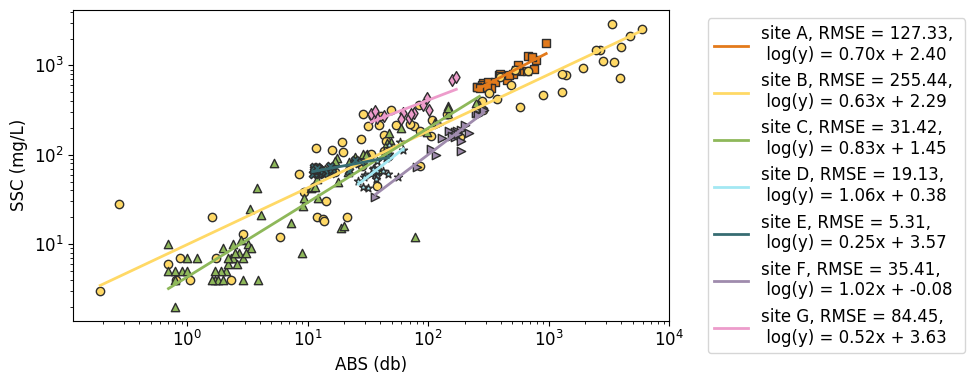

In [4]:
plt.figure(figsize=(10, 4))

for i, id in enumerate(alpha_site_id):
    colr = colr_sc[i]
    mod = lisst_data_dict[id]
    
    # Scatter plot
    x = np.array(mod[x_key]).reshape(-1, 1)
    y = np.array(mod[y_key]).reshape(-1, 1)
    plt.scatter(x, y, color=colr, marker=markers[i], edgecolors='#2E2E2E', zorder=1)
    
    # Use log of y for linear regression
    log_y = np.log(y)
    x = np.log(x)  # Log transform x as well for consistency
    
    # Linear regression
    model = LinearRegression()
    model.fit(x, log_y)
    log_y_pred = model.predict(x)
    
    # Sort the data for plotting
    sorted_indices = np.argsort(x.ravel())
    x_sorted = x[sorted_indices]
    log_y_pred_sorted = log_y_pred[sorted_indices]
    
    # Calculate the slope and intercept
    slope = model.coef_[0, 0]
    intercept = model.intercept_[0]
    
    # Calculate RMSE using log values
    log_rmse = np.sqrt(mean_squared_error(log_y, log_y_pred))

    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(np.exp(log_y), np.exp(log_y_pred)))
    
    # Plot the fitted line in the original scale
    plt.plot(np.exp(x_sorted), np.exp(log_y_pred_sorted), linewidth=2, color=colr, 
             label=f'site {id}, RMSE = {rmse:.2f}, \n log(y) = {slope:.2f}x + {intercept:.2f}')

plt.yscale('log')
plt.xscale('log')
plt.xlabel(f'{x_key} (db)')
plt.ylabel(f'{y_key} (mg/L)')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
# plt.savefig('figures/linear_fit.png' , dpi=500) 

plt.show()



# Run GP baseline for each site

In [44]:
from sklearn.metrics import mean_squared_error
import warnings
from sklearn.exceptions import UndefinedMetricWarning, ConvergenceWarning

with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=UndefinedMetricWarning)
    warnings.filterwarnings("ignore", category=ConvergenceWarning)
    warnings.filterwarnings("ignore", category=UserWarning, message="One or more of the test scores are non-finite")

def extract_kernel_hyperparams(kernel):
    params = {}
    all_params = kernel.get_params()

    for name, val in all_params.items():
        # Only keep float/numeric hyperparameters (not subkernels)
        if isinstance(val, (float, int, np.float64, np.int64)):
            params[name] = val

    return params
    
def GP(
    SAC_m, SSC_m, p,
    SAC_log=False, SSC_log=False,
    hyperparams=-999,
    global_min_X=None, global_max_X=None,
    global_min_Y=None, global_max_Y=None,
    SAC_test=None, SSC_test=None,
):
    # Use global min/max if provided
    if global_min_X is not None and global_max_X is not None:
        min_SAC = global_min_X
        max_SAC = global_max_X
    else:
        min_SAC = SAC_m.min()
        max_SAC = SAC_m.max()

    x_range = max_SAC - min_SAC
    if x_range < 1e-8:
        raise ValueError("Input x has too small a range to normalize reliably.")
    X = ((SAC_m - min_SAC) / x_range).reshape(-1, 1)

    if global_min_Y is not None and global_max_Y is not None:
        min_SSC = global_min_Y
        max_SSC = global_max_Y
    else:
        min_SSC = SSC_m.min()
        max_SSC = SSC_m.max()

    y_range = max_SSC - min_SSC
    if y_range < 1e-8:
        raise ValueError("Target y has too small a range to normalize reliably.")
    y = ((SSC_m - min_SSC) / y_range).reshape(-1, 1)

    if SAC_log:
        X = np.log10(X + 1e-8)
    if SSC_log:
        y = np.log10(y + 1e-6)

    # Prepare test set if given
    if SAC_test is not None and SSC_test is not None:
        X_test = ((SAC_test - min_SAC) / x_range).reshape(-1, 1)
        y_test = ((SSC_test - min_SSC) / y_range).reshape(-1, 1)
        if SAC_log:
            X_test = np.log10(X_test + 1e-8)
        if SSC_log:
            y_test = np.log10(y_test + 1e-6)
    else:
        X_test, y_test = None, None

    best_rmse = float('inf')
    best_model = None
    best_alpha = None
    best_kernel = None
    best_kernel_params = None
    best_std = None
    best_score = None
    best_log_marg = None


    kernel = ConstantKernel(0.3, (0.05, 0.8)) * RBF(length_scale=0.5, length_scale_bounds=(0.3, 2))
    gp = GaussianProcessRegressor(kernel=kernel, normalize_y=False)
    alphas = np.logspace(-2, -1, 10)
    search = GridSearchCV(gp, {'alpha': alphas}, cv=min(5, len(X)))
    search.fit(X, y.ravel())

    best_model = search.best_estimator_
    best_alpha = search.best_params_['alpha']
    best_kernel = best_model.kernel_
    best_score = best_model.score(X, y.ravel())
    best_log_marg = best_model.log_marginal_likelihood()

    # Predict across domain and 10% farther than upper bound
    SAC_pred = np.linspace(0, 1.1, p).reshape(-1, 1)
    Y_pred_scaled, std_scaled = best_model.predict(SAC_pred, return_std=True)
    Y_pred_orig = Y_pred_scaled * y_range + min_SSC
    std_orig = std_scaled * y_range
    SAC_pred_orig = SAC_pred.ravel() * x_range + min_SAC

    return (
        SAC_pred_orig, Y_pred_orig, std_orig,
        best_score, best_log_marg,
        best_model, best_alpha,
        (min_SAC, x_range), (min_SSC, y_range)
    )


In [6]:
from sklearn.model_selection import KFold
import numpy as np
import math
from sklearn.model_selection import StratifiedKFold

model_dictionary = {}

p = 100  # number of prediction points

import warnings

with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UndefinedMetricWarning)
    warnings.simplefilter("ignore", category=ConvergenceWarning)
    warnings.simplefilter("ignore", category=UserWarning)
    
for site_id in alpha_site_id:
    site_data = lisst_data_dict[site_id]
    xdata = np.array(site_data[x_key])
    ydata = np.array(site_data[y_key])

    global_min_x = xdata.min()
    global_max_x = xdata.max()
    global_min_y = ydata.min()
    global_max_y = ydata.max()

    if len(xdata) < 3:
        print(f"Skipping site {site_id}, too few samples.")
        continue

    model_dictionary[site_id] = {'folds': {}, 'num_samp': len(xdata)}

    n_splits = min(5, len(xdata))
    n_bins = min(10, len(xdata) // n_splits)
    x_binned = np.floor(np.interp(xdata, (xdata.min(), xdata.max()), (0, n_bins))).astype(int)

    skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=0)

    for fold_idx, (train_idx, test_idx) in enumerate(skf.split(xdata, x_binned)):

    # kf = KFold(n_splits=min(5, len(xdata)), shuffle=True, random_state=0)

    # for fold_idx, (train_idx, test_idx) in enumerate(kf.split(xdata)):
        x_train, y_train = xdata[train_idx], ydata[train_idx]
        x_test, y_test = xdata[test_idx], ydata[test_idx]

        try:
            SAC_pred, SSC_pred, std_pred, score, log_marg, model, alpha, x_scale, y_scale = GP(
                x_train, y_train, p,
                SAC_test=x_test, SSC_test=y_test,
                global_min_X=global_min_x, global_max_X=global_max_x,
                global_min_Y=global_min_y, global_max_Y=global_max_y,
            )
        except Exception as e:
            print(f"Fold {fold_idx} failed for site {site_id}: {e}")
            continue

        kernel_params = extract_kernel_hyperparams(model.kernel_)

        x_min, x_range = x_scale
        x_test_scaled = (x_test - x_min) / x_range
        ypred_test_scaled, std_test_scaled = model.predict(x_test_scaled.reshape(-1, 1), return_std=True)

        y_min, y_range = y_scale
        ypred_test = ypred_test_scaled * y_range + y_min
        std_test = std_test_scaled * y_range

        rmse = math.sqrt(np.mean((y_test - ypred_test) ** 2))
        r2 = model.score(x_test_scaled.reshape(-1, 1), (y_test - y_min) / y_range)

        model_dictionary[site_id]['folds'][fold_idx] = {
            'x_train': x_train,
            'y_train': y_train,
            'x_test': x_test,
            'y_test': y_test,
            'n_pred': ypred_test,
            'p_pred': [SAC_pred, SSC_pred, std_pred],
            'scores': {
                'rmse': rmse,
                'r_score': r2,
                'GP_score': score,
                'GP_logmarg': log_marg,
                'alpha': alpha,
                'std': std_test,
            },
            'model': model,
            'hyperparams': kernel_params,
            'x_scaling': x_scale,
            'y_scaling': y_scale,
        }

        print(f"Site {site_id} | Fold {fold_idx} | RMSE: {rmse:.2f} | R^2: {r2:.2f}")

#save median gp_score fold as baseline model

for site_id in model_dictionary:
    fold_data = model_dictionary[site_id].get('folds', {})

    if not fold_data:
        continue  # Skip if no folds available

    # Extract GP scores from all folds
    fold_scores = [(fold_idx, fold['scores']['GP_score']) for fold_idx, fold in fold_data.items()]
    sorted_scores = sorted(fold_scores, key=lambda x: x[1])  # Sort by GP_score

    # Find the median score and corresponding fold
    mid = len(sorted_scores) // 2
    median_fold_idx = sorted_scores[mid][0]  # Use floor of mid (can also average if even count)

    # Save that fold's data as baseline
    model_dictionary[site_id]['baseline'] = {
        'fold_idx': median_fold_idx,
        **fold_data[median_fold_idx]
    }

    print(f"Site {site_id} baseline set to fold {median_fold_idx} with GP_score = {sorted_scores[mid][1]:.3f}")



/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py

Site A | Fold 0 | RMSE: 99.60 | R^2: 0.84
Site A | Fold 1 | RMSE: 90.67 | R^2: 0.80


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn

Site A | Fold 2 | RMSE: 56.10 | R^2: 0.94
Site A | Fold 3 | RMSE: 200.54 | R^2: -0.88


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.wa

Site A | Fold 4 | RMSE: 299.64 | R^2: 0.49


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

Site B | Fold 0 | RMSE: 160.53 | R^2: 0.92
Site B | Fold 1 | RMSE: 137.56 | R^2: 0.92


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.wa

Site B | Fold 2 | RMSE: 329.09 | R^2: 0.33


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


Site B | Fold 3 | RMSE: 487.16 | R^2: 0.58


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.

Site B | Fold 4 | RMSE: 306.14 | R^2: 0.80


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn

Site C | Fold 0 | RMSE: 29.91 | R^2: 0.93


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn

Site C | Fold 1 | RMSE: 51.56 | R^2: 0.20
Site C | Fold 2 | RMSE: 25.02 | R^2: 0.94
Site C | Fold 3 | RMSE: 25.68 | R^2: 0.90


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


Site C | Fold 4 | RMSE: 20.77 | R^2: 0.94
Site D | Fold 0 | RMSE: 14.73 | R^2: 0.59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420

Site D | Fold 1 | RMSE: 15.50 | R^2: 0.52
Site D | Fold 2 | RMSE: 29.32 | R^2: -1.48


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

Site D | Fold 3 | RMSE: 28.86 | R^2: 0.07
Site D | Fold 4 | RMSE: 24.73 | R^2: 0.43


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420

Site E | Fold 0 | RMSE: 5.78 | R^2: -2.10
Site E | Fold 1 | RMSE: 2.21 | R^2: 0.85


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn

Site E | Fold 2 | RMSE: 7.11 | R^2: 0.42
Site E | Fold 3 | RMSE: 4.07 | R^2: 0.59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

Site E | Fold 4 | RMSE: 14.91 | R^2: -0.13
Site F | Fold 0 | RMSE: 28.46 | R^2: 0.87


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

Site F | Fold 1 | RMSE: 55.39 | R^2: -0.59
Site F | Fold 2 | RMSE: 51.44 | R^2: 0.66


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn

Site F | Fold 3 | RMSE: 36.23 | R^2: 0.66
Site F | Fold 4 | RMSE: 26.64 | R^2: 0.67


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.

Site G | Fold 0 | RMSE: 47.72 | R^2: 0.55
Site G | Fold 1 | RMSE: 20.60 | R^2: 0.71
Site G | Fold 2 | RMSE: 61.61 | R^2: -3.31
Site G | Fold 3 | RMSE: 13.84 | R^2: 1.00


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

Site G | Fold 4 | RMSE: 111.71 | R^2: 0.74
Site A baseline set to fold 0 with GP_score = 0.811
Site B baseline set to fold 0 with GP_score = 0.796
Site C baseline set to fold 4 with GP_score = 0.891
Site D baseline set to fold 4 with GP_score = 0.471
Site E baseline set to fold 1 with GP_score = 0.738
Site F baseline set to fold 3 with GP_score = 0.728
Site G baseline set to fold 1 with GP_score = 0.966


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

In [7]:
print(model_dictionary['A']['baseline']['hyperparams'])

{'k1__constant_value': 0.42385624714319725, 'k2__length_scale': 1.1102089104368698}


Site  Fold  RMSE  GP_score  GP_logmarg  Alpha                             Kernel
   A     0 100.0  0.811017    6.757402   0.04  0.651**2 * RBF(length_scale=1.11)
   A     1  91.0  0.826867    6.716404   0.04   0.684**2 * RBF(length_scale=1.1)
   A     2  56.0  0.798830    6.482660   0.04  0.653**2 * RBF(length_scale=1.09)
   A     3 201.0  0.924578   15.463272   0.01  0.894**2 * RBF(length_scale=1.15)
   A     4 300.0  0.806738   16.229658   0.01 0.344**2 * RBF(length_scale=0.728)
   B     0 161.0  0.796125   40.792514   0.01 0.638**2 * RBF(length_scale=0.537)
   B     1 138.0  0.786629   34.835694   0.02  0.703**2 * RBF(length_scale=1.14)
   B     2 329.0  0.852076   47.370556   0.01   0.79**2 * RBF(length_scale=1.25)
   B     3 487.0  0.905858   55.810219   0.01 0.562**2 * RBF(length_scale=0.439)
   B     4 306.0  0.788506   45.420042   0.01 0.519**2 * RBF(length_scale=0.755)
   C     0  30.0  0.882095   54.506342   0.01  0.894**2 * RBF(length_scale=1.04)
   C     1  52.0  0.955246  

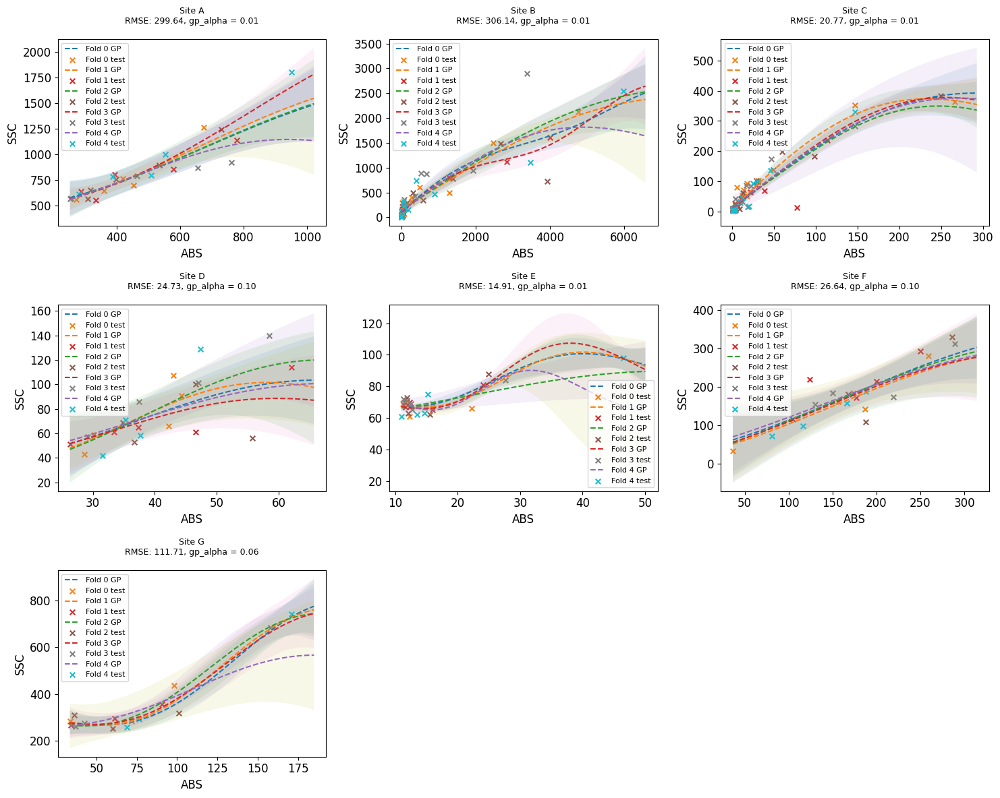

In [8]:
from collections import defaultdict

site_ids = list(model_dictionary.keys())
n_sites = len(site_ids)
n_cols = 3
n_rows = math.ceil(n_sites / n_cols)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 4 * n_rows), sharex=False, sharey=False)
axes = axes.flatten()

# Collect metrics into a list of dicts
summary_rows = []

for i, site_id in enumerate(site_ids):
    ax = axes[i]
    model = model_dictionary[site_id]

    # Plot each fold’s test prediction
    folds = model.get("folds", {})
    for fold_id, fold_data in folds.items():
        try:
            kernel_str = str(fold_data['model'].kernel_)
        except Exception as e:
            kernel_str = f"Kernel: Unknown ({e})"   
            
        test_x = fold_data['x_test']
        test_y = fold_data['y_test']
        ypred = fold_data['n_pred']
        SAC_pred_all, SSC_pred_all, std_pred_all = fold_data['p_pred']
        std_pred = fold_data['scores']['std']
        gp_alpha = fold_data['scores']['alpha']
        rmse = fold_data['scores']['rmse']
        summary_rows.append({
            "Site": site_id,
            "Fold": fold_id,
            "RMSE": round(rmse, 0),
            "GP_score": fold_data['scores']['GP_score'],
            "GP_logmarg": fold_data['scores']['GP_logmarg'],
            "Alpha": round(gp_alpha, 2),
            "Kernel": kernel_str
        })

       

        sorted_idx = np.argsort(test_x)
        test_x_sorted = test_x[sorted_idx]
        ypred_sorted = ypred[sorted_idx]
        std_sorted = std_pred[sorted_idx]

        ax.plot(SAC_pred_all, SSC_pred_all, linestyle='--', linewidth=1.5, label=f'Fold {fold_id} GP')
        ax.fill_between(
            SAC_pred_all,
            SSC_pred_all - 1.96 * std_pred_all,
            SSC_pred_all + 1.96 * std_pred_all,
            alpha=0.1
        )
        ax.scatter(test_x, test_y, marker='x', s=30, label=f'Fold {fold_id} test')

  

    ax.set_title(
        f"Site {site_id}\nRMSE: {rmse:.2f}, gp_alpha = {gp_alpha:.2f}\n",
        fontsize=9
    )
    ax.set_xlabel(x_key)
    ax.set_ylabel(y_key)

    # Remove duplicate labels
    handles, labels = ax.get_legend_handles_labels()
    unique_labels = dict(zip(labels, handles))
    ax.legend(unique_labels.values(), unique_labels.keys(), fontsize=8)

# Turn off unused subplots
for j in range(len(site_ids), len(axes)):
    axes[j].axis('off')

# Convert to DataFrame and print
summary_df = pd.DataFrame(summary_rows)
print(summary_df.to_string(index=False))

plt.tight_layout()
plt.show()


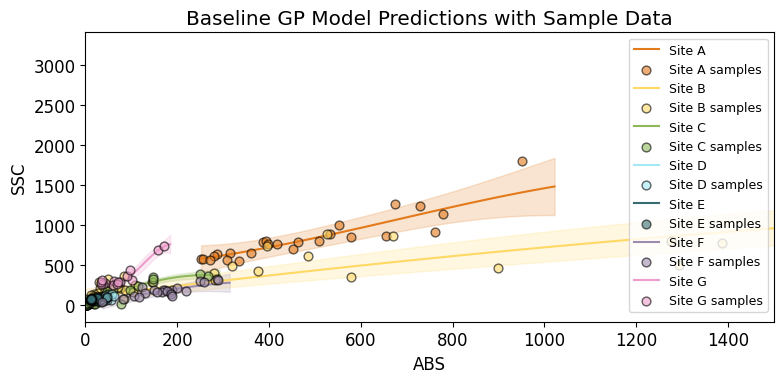


Baseline Model Summary:
Site   RMSE  GP_score  GP_logmarg  Alpha                             Kernel
   A  99.60     0.811         6.8  0.036  0.651**2 * RBF(length_scale=1.11)
   B 160.53     0.796        40.8  0.010 0.638**2 * RBF(length_scale=0.537)
   C  20.77     0.891        53.3  0.010 0.845**2 * RBF(length_scale=0.977)
   D  24.73     0.471        -2.6  0.100  0.47**2 * RBF(length_scale=0.935)
   E   2.21     0.738         1.1  0.010 0.666**2 * RBF(length_scale=0.416)
   F  36.23     0.728        -1.6  0.100 0.667**2 * RBF(length_scale=0.991)
   G  20.60     0.966         5.9  0.010 0.668**2 * RBF(length_scale=0.584)


In [9]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

fig, ax = plt.subplots(figsize=(8, 4))

baseline_rows = []

for i, site_id in enumerate(model_dictionary.keys()):
    model = model_dictionary[site_id]
    baseline_info = model.get('baseline')
    site_data = lisst_data_dict[site_id]
    xdata = np.array(site_data[x_key])
    ydata = np.array(site_data[y_key])

    if baseline_info is None:
        print(f"No baseline model for site {site_id}")
        continue

    SAC_pred_all, SSC_pred_all, std_pred_all = baseline_info['p_pred']
    rmse = baseline_info['scores']['rmse']
    gp_score = baseline_info['scores']['GP_score']
    gp_logmarg = baseline_info['scores']['GP_logmarg']
    gp_alpha = baseline_info['scores']['alpha']
    kernel_str = str(baseline_info['model'].kernel_)

    # Plot model prediction and CI
    ax.plot(SAC_pred_all, SSC_pred_all, color=colr_sc[i], label=f"Site {site_id}", zorder=1)
    ax.fill_between(
        SAC_pred_all,
        SSC_pred_all - 1.96 * std_pred_all,
        SSC_pred_all + 1.96 * std_pred_all,
        color=colr_sc[i],
        alpha=0.2,
        zorder=0,
    )

    # Plot observed samples
    ax.scatter(xdata, ydata, color=colr_sc[i], marker='o', edgecolor='k', s=40, alpha=0.6, label=f"Site {site_id} samples", zorder=2)

    # Save summary info
    baseline_rows.append({
        "Site": site_id,
        "RMSE": round(rmse, 2),
        "GP_score": round(gp_score, 3),
        "GP_logmarg": round(gp_logmarg, 1),
        "Alpha": round(gp_alpha, 3),
        "Kernel": kernel_str
    })

# Plot formatting
ax.set_title("Baseline GP Model Predictions with Sample Data")
ax.set_xlabel(x_key)
ax.set_ylabel(y_key)

# Deduplicate legend
handles, labels = ax.get_legend_handles_labels()
unique = dict(zip(labels, handles))
ax.legend(unique.values(), unique.keys(), fontsize=9)
plt.xlim(0,1500) 

plt.tight_layout()
plt.show()




# Print summary table
summary_df = pd.DataFrame(baseline_rows)
print("\nBaseline Model Summary:")
print(summary_df.to_string(index=False))


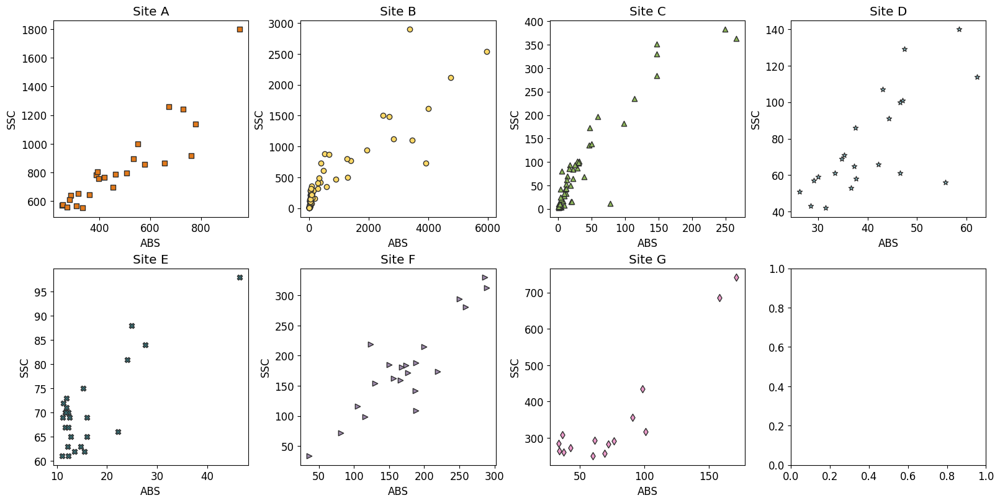

In [ ]:
# plot data distribution

n_sites = len(alpha_site_id)
ncols = 4  # you can change this based on how wide you want the figure
nrows = int(np.ceil(n_sites / ncols))

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 4), constrained_layout=True)
axs = axs.flatten()

for i, id in enumerate(alpha_site_id):
    ax = axs[i]
    colr = colr_sc[i]
    mod = lisst_data_dict.get(id)

    x = np.array(mod[x_key])
    y = np.array(mod[y_key])

    valid_mask = (~np.isnan(x)) & (~np.isnan(y))
    x = x[valid_mask].reshape(-1, 1)
    y = y[valid_mask].reshape(-1, 1)

    if x.size == 0 or y.size == 0:
        ax.set_title(f"Site {id} (no data)")
        continue
    else:
        ax.set_title(f"Site {id}")

    ax.scatter(x, y, color=colr, marker=markers[i % len(markers)], edgecolors='#2E2E2E', zorder=1)

    ax.set_xlabel(x_key)
    ax.set_ylabel(y_key)

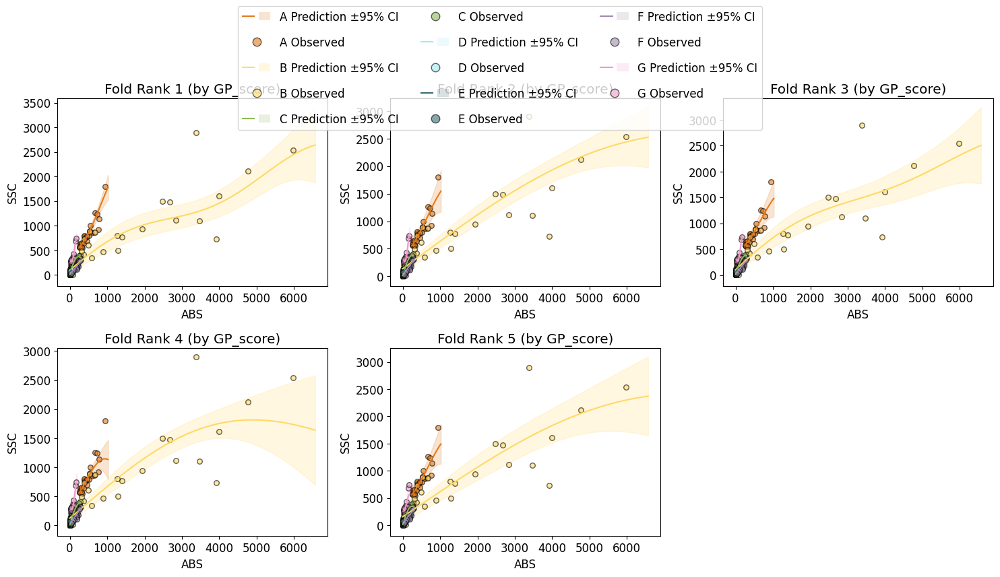

In [37]:
# Get number of folds per site
num_folds = max(len(model['folds']) for model in model_dictionary.values())

# Setup subplots
ncols = 3
nrows = int(np.ceil(num_folds / ncols))
fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 4*nrows), squeeze=False)

# For shared legend
legend_handles = []
legend_labels = []
added_sites = set()

for fold_rank in range(num_folds):
    ax = axes[fold_rank // ncols][fold_rank % ncols]
    ax.set_title(f"Fold Rank {fold_rank + 1} (by GP_score)")

    for site_idx, (site_id, model) in enumerate(model_dictionary.items()):
        model = model_dictionary[site_id]
        baseline_info = model.get('baseline')
        site_data = lisst_data_dict[site_id]
        xdata = np.array(site_data[x_key])
        ydata = np.array(site_data[y_key])
        # site_data = model_dictionary[site_id]
        # xdata = np.array(site_data[x_key])
        # ydata = np.array(site_data[y_key])


        folds = model.get('folds', {})
        if not folds:
            continue

        # Sort folds by GP_score descending
        sorted_folds = sorted(folds.items(), key=lambda x: x[1]['scores']['GP_score'], reverse=True)
        if fold_rank >= len(sorted_folds):
            continue

        fold_idx, fold_info = sorted_folds[fold_rank]
        SAC_pred_all, SSC_pred_all, std_pred_all = fold_info['p_pred']

        color = colr_sc[site_idx % len(colr_sc)]  # Cycle colors

        # Plot GP prediction
        ax.plot(SAC_pred_all, SSC_pred_all, color=color)

        # Plot confidence interval
        ax.fill_between(
            SAC_pred_all,
            SSC_pred_all - 1.96 * std_pred_all,
            SSC_pred_all + 1.96 * std_pred_all,
            color=color,
            alpha=0.2
        )

        # Plot observed data
        ax.scatter(xdata, ydata, color=color, edgecolor='k', s=30, alpha=0.6)

        # Add custom legend entries once per site
        if site_id not in added_sites:
            # Combined prediction line + shaded area
            pred_line = Line2D([], [], color=color)
            ci_patch = Patch(facecolor=color, alpha=0.2)
            legend_handles.append((pred_line, ci_patch))
            legend_labels.append(f"{site_id} Prediction ±95% CI")

            # Observed marker
            obs_marker = Line2D([], [], color=color, marker='o', linestyle='None',
                                markeredgecolor='k', alpha=0.6)
            legend_handles.append(obs_marker)
            legend_labels.append(f"{site_id} Observed")

            added_sites.add(site_id)

    ax.set_xlabel(x_key)
    ax.set_ylabel(y_key)

# Remove empty subplots if any
total_plots = nrows * ncols
for idx in range(num_folds, total_plots):
    fig.delaxes(axes[idx // ncols][idx % ncols])

# Shared legend at top
fig.legend(
    handles=legend_handles,
    labels=legend_labels,
    handler_map={tuple: HandlerTuple(ndivide=None)},
    loc='upper center',
    ncol=3,  # Adjust based on number of sites
    fontsize=12,
    handlelength=2.5,
    markerscale=1.5,
    labelspacing=1.2,
    bbox_to_anchor=(0.5, 1.08)
)

plt.tight_layout(rect=[0, 0, 1, 0.95])  # Leave space at the top for legend
plt.show()


In [ ]:
# Initialize the new dictionary
cross_prediction_dictionary = {site_id: {} for site_id in alpha_site_id}

# Loop through each combination of test and model sites
for model_id in alpha_site_id:
    for site_id in alpha_site_id:
        # Get the model from the model_dictionary
        GP_model = model_dictionary[model_id]['baseline']['model']

        # Get the test site data
        test_data = lisst_data_dict[site_id]
        # x_test = test_data['Samples']['SAC'].to_numpy()
        # y_test = test_data['Samples']['SSC'].to_numpy()
        x_test = np.array(test_data[x_key])
        y_test = np.array(test_data[y_key])

        x_range = max(x_test) - min(x_test)
        y_range = max(y_test) - min(y_test)

        x_test_scaled = (x_test - min(x_test)) / x_range
    

        # Use the model to predict SSC for the test data
        y_pred_scaled, std_pred_scaled = GP_model.predict(x_test_scaled.reshape(-1, 1), return_std=True)

        y_pred = y_pred_scaled * y_range + min(y_test)
        std_pred = std_pred_scaled * y_range
        # Calculate scores
        MSE = np.square(np.subtract(y_test, y_pred)).mean()
        rmse = math.sqrt(MSE)
        r_score = GP_model.score(y_pred.reshape(-1, 1), y_test.reshape(-1, 1))

        hp =  extract_kernel_hyperparams(GP_model.kernel_)

        # Store the results in the new dictionary
        cross_prediction_dictionary[site_id][model_id] = {
            'hyperparams': hp,
            'x': x_test,
            'y': y_test,
            'n_pred': ypred,
            'scores': {
                'r_score': r_score, 
                'rmse' : rmse, 
                'std': std_pred
            },
            'model': GP_model
                                           
        }

[286 281 316 418 387 393 579 552 778 952 397 508 655 674 729 360 453 464
 533 761 252 256 334 271 308]
[1.845e+02 5.781e+02 8.995e+02 3.750e+02 2.128e+01 1.191e+01 1.349e+01
 1.355e+01 1.294e+03 3.467e+03 1.387e+03 1.072e+02 2.831e+03 1.932e+03
 3.784e+01 3.373e+03 5.970e+03 4.764e+03 3.999e+03 2.320e+00 8.472e+01
 2.805e+02 1.276e+03 3.192e+02 1.050e+00 1.445e+02 2.679e+03 2.477e+03
 3.926e+03 8.433e+01 3.926e+01 3.148e+01 2.754e+01 1.914e+01 1.585e+01
 1.950e+01 5.860e+00 4.036e+01 8.700e-01 2.871e+01 1.180e+01 8.470e+00
 1.600e+00 4.305e+01 7.621e+01 5.445e+01 2.910e+00 8.100e-01 4.305e+01
 8.551e+01 1.675e+01 9.330e+00 1.406e+01 2.805e+01 1.047e+02 2.831e+02
 2.700e-01 1.900e-01 6.900e-01 3.357e+01 4.853e+02 5.272e+02 4.898e+01
 4.446e+01 7.112e+01 6.699e+02 3.945e+02 1.730e+00]
[  0.8   1.7   3.9   0.8   0.7   1.8   0.7   2.1   2.    2.    1.6   2.3
   0.9   1.    2.4   1.   18.8 266.   59.2  28.7  38.9   9.2   7.3  77.3
   8.9   2.2   2.6   2.2   1.2   1.9   3.2   2.7   2.4   2.5

In [11]:

print("RMSE for all sites with different models used to predict on it:")

for site_id in alpha_site_id:
    print(f"\nTest Site: {site_id}")
    # base_r, base_rmse = model_dictionary[site_id]['scores'][2:4]
    # print(f"  Baseline from Site {site_id}: RMSE = {base_rmse:.2f}; R = {base_r:.2f}")

    for i, model_id in enumerate(alpha_site_id):
        rmse = cross_prediction_dictionary[site_id][model_id]['scores']['rmse']
        r = cross_prediction_dictionary[site_id][model_id]['scores']['r_score']
        print(f"  Model from Site {model_id}: RMSE = {rmse:.0f}")


RMSE for all sites with different models used to predict on it:

Test Site: A
  Model from Site A: RMSE = 120
  Model from Site B: RMSE = 193
  Model from Site C: RMSE = 341
  Model from Site D: RMSE = 179
  Model from Site E: RMSE = 374
  Model from Site F: RMSE = 167
  Model from Site G: RMSE = 144

Test Site: B
  Model from Site A: RMSE = 338
  Model from Site B: RMSE = 252
  Model from Site C: RMSE = 353
  Model from Site D: RMSE = 351
  Model from Site E: RMSE = 527
  Model from Site F: RMSE = 277
  Model from Site G: RMSE = 391

Test Site: C
  Model from Site A: RMSE = 60
  Model from Site B: RMSE = 41
  Model from Site C: RMSE = 29
  Model from Site D: RMSE = 58
  Model from Site E: RMSE = 53
  Model from Site F: RMSE = 46
  Model from Site G: RMSE = 67

Test Site: D
  Model from Site A: RMSE = 21
  Model from Site B: RMSE = 20
  Model from Site C: RMSE = 27
  Model from Site D: RMSE = 20
  Model from Site E: RMSE = 29
  Model from Site F: RMSE = 19
  Model from Site G: RMSE = 2

## Compute correlation matricies

In [12]:
def const_rbf_kernel(x, y, length_scale, const):
    rbf = math.exp(- math.dist([x],[y]) / (2*length_scale**2) )
    return const * rbf

def cov_to_cor(cov):
    d = np.sqrt(np.diag(cov))
    return cov / np.outer(d, d)

correlation_matrices = {}
n_range = [10, 25, 50]

for id in alpha_site_id:
    correlation_matrices[id] = {}
    
    if 'baseline' not in model_dictionary[id]:
        print(f"Skipping site {id}, no baseline model found.")
        continue

    mod = model_dictionary[id]['baseline']
    x = np.array(mod['x_train'])
    y = np.array(mod['y_train'])
    # pred_x = np.array(mod['p_pred'][0])
    # pred_y = np.array(mod['p_pred'][1])

    # Hyperparameters 
    hp = mod['hyperparams']
    const = hp.get('k1__constant_value', None)
    l = hp.get('k2__length_scale', None)

    if l is None or const is None:
        raise ValueError(f"Missing hyperparameters in site {id}")

    # Sort input data
    ord = np.argsort(x)
    x_sort = x[ord]
    y_sort = y[ord]

    x_min = np.min(x_sort)
    x_max = np.max(x_sort)
    x_sort_scaled = (x_sort - x_min) / (x_max - x_min)

    # --- Variable number of prediction points using this site's kernel ---
    correlation_matrices[id]['n'] = {}
    for n in n_range:
        nx_trend_scaled = np.linspace(0, 1, n)
        kern = np.zeros((n, n))
        for i in range(n):
            for j in range(n):
                kern[i, j] = const_rbf_kernel(nx_trend_scaled[i], nx_trend_scaled[j], l, const)
        cor_mat = cov_to_cor(kern)

        correlation_matrices[id]['n'][n] = {
            'hyperparams': {
                'length_scale': l,
                'constant_value': const,
            },
            'cor_matrix': cor_mat,
            'range': nx_trend_scaled * (x_max - x_min) + x_min,
            'range_scaled': nx_trend_scaled,
        }

    # --- Evaluate all other sites' kernels on this site's inputs ---
    correlation_matrices[id]['num_samp'] = {}
    for model_id in alpha_site_id:
        if 'baseline' not in model_dictionary[model_id]:
            print(f"Skipping model from {model_id}, no baseline.")
            continue

        hp_mod = model_dictionary[model_id]['baseline']['hyperparams']
        const_mod = hp_mod.get('k1__constant_value', None)
        l_mod = hp_mod.get('k2__length_scale', None)

        if const_mod is None or l_mod is None:
            continue

        samp_n = len(x_sort_scaled)
        kern = np.zeros((samp_n, samp_n))
        for i in range(samp_n):
            for j in range(samp_n):
                kern[i, j] = const_rbf_kernel(x_sort_scaled[i], x_sort_scaled[j], l_mod, const_mod)
        cor_mat = cov_to_cor(kern)

        correlation_matrices[id]['num_samp'][model_id] = {
            'hyperparams': {
                'length_scale': l_mod,
                'constant_value': const_mod,
            },
            'cor_matrix': cor_mat,
            'range': x_sort,
            'range_scaled': x_sort_scaled,
            'n': samp_n,
        }

        print(f"→ Site {id} using model {model_id}: corr shape {cor_mat.shape}")



→ Site A using model A: corr shape (20, 20)
→ Site A using model B: corr shape (20, 20)
→ Site A using model C: corr shape (20, 20)
→ Site A using model D: corr shape (20, 20)
→ Site A using model E: corr shape (20, 20)
→ Site A using model F: corr shape (20, 20)
→ Site A using model G: corr shape (20, 20)
→ Site B using model A: corr shape (54, 54)
→ Site B using model B: corr shape (54, 54)
→ Site B using model C: corr shape (54, 54)
→ Site B using model D: corr shape (54, 54)
→ Site B using model E: corr shape (54, 54)
→ Site B using model F: corr shape (54, 54)
→ Site B using model G: corr shape (54, 54)
→ Site C using model A: corr shape (59, 59)
→ Site C using model B: corr shape (59, 59)
→ Site C using model C: corr shape (59, 59)
→ Site C using model D: corr shape (59, 59)
→ Site C using model E: corr shape (59, 59)
→ Site C using model F: corr shape (59, 59)
→ Site C using model G: corr shape (59, 59)
→ Site D using model A: corr shape (18, 18)
→ Site D using model B: corr sha

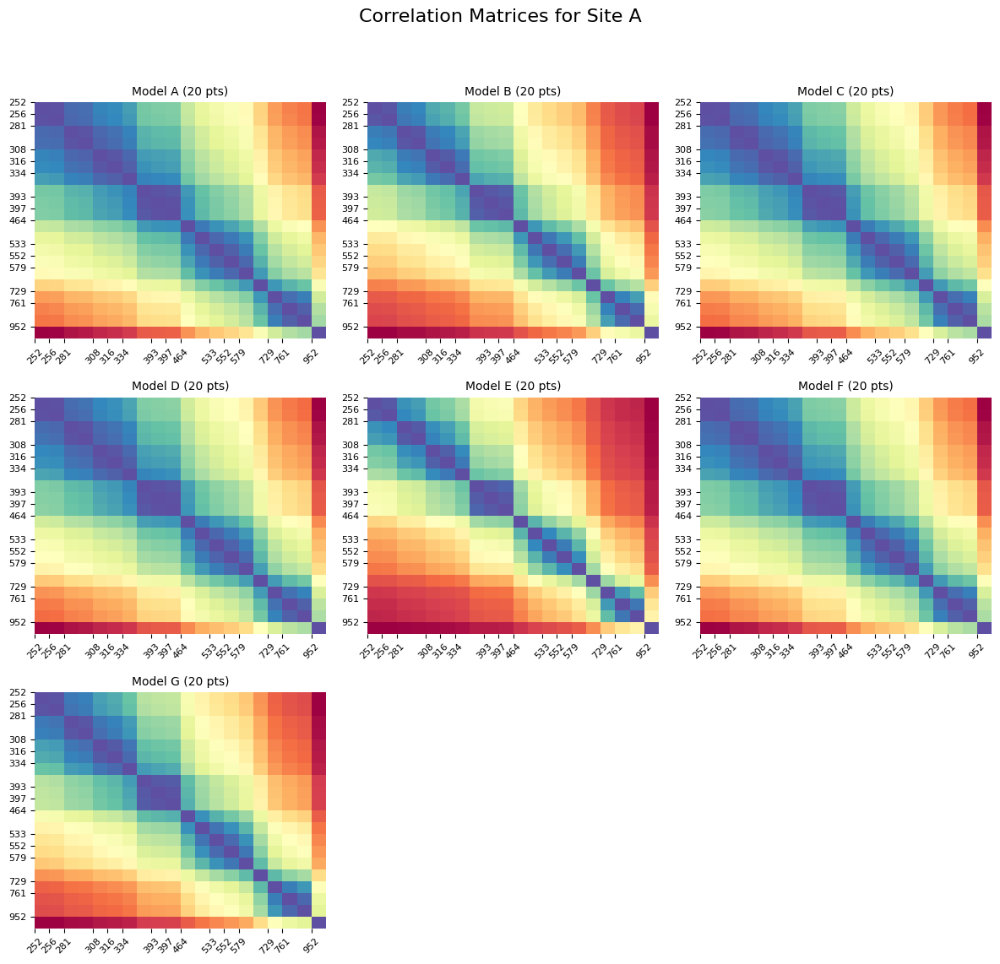

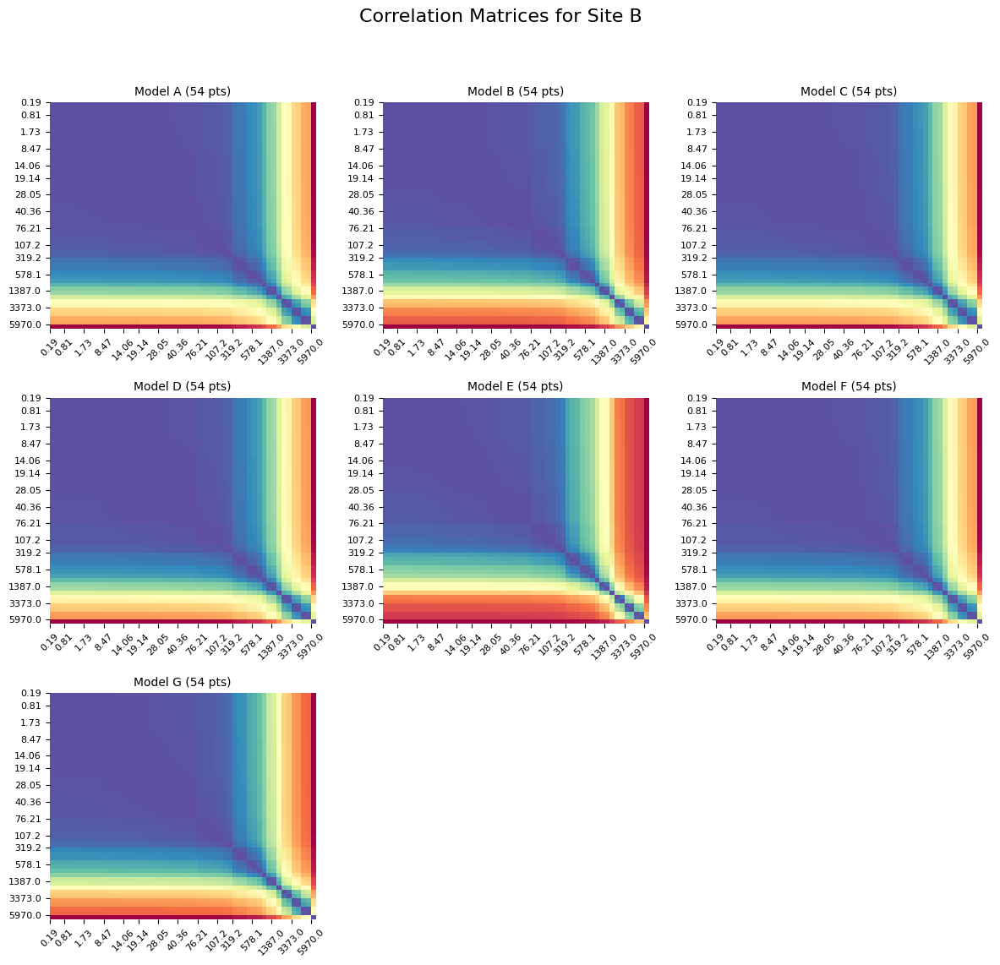

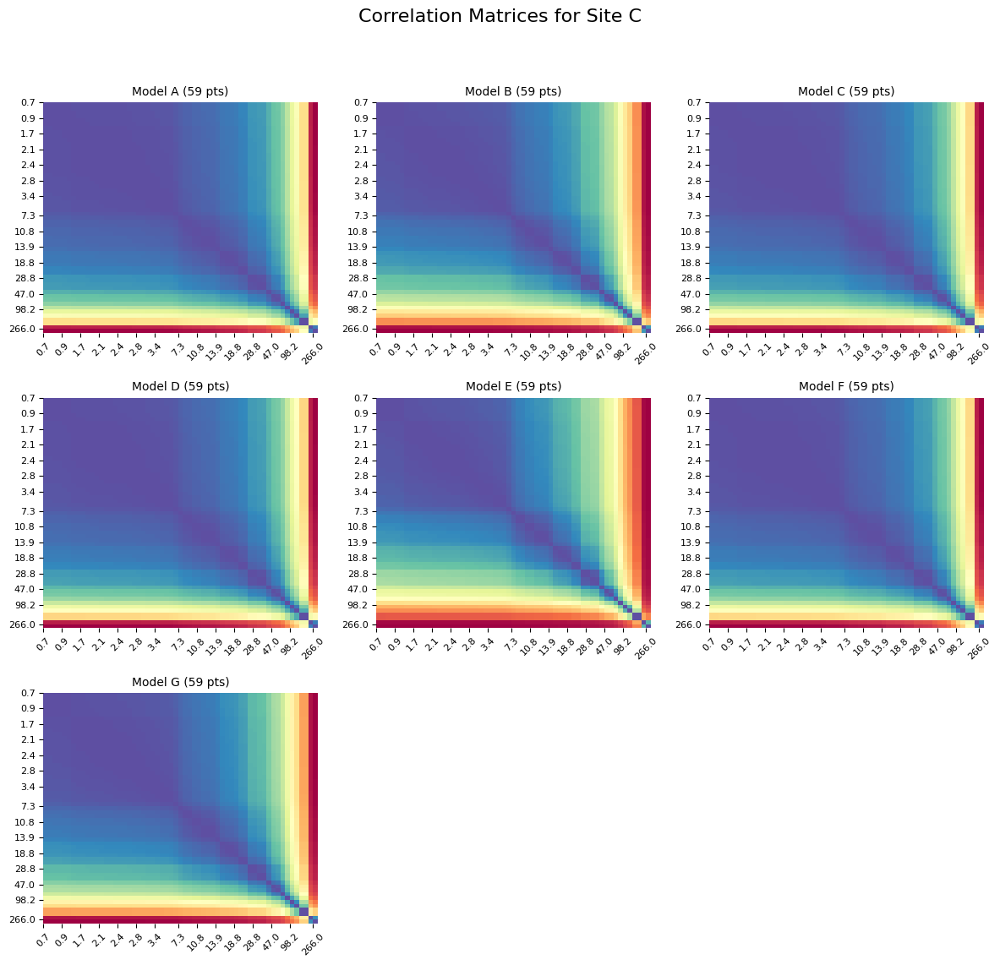

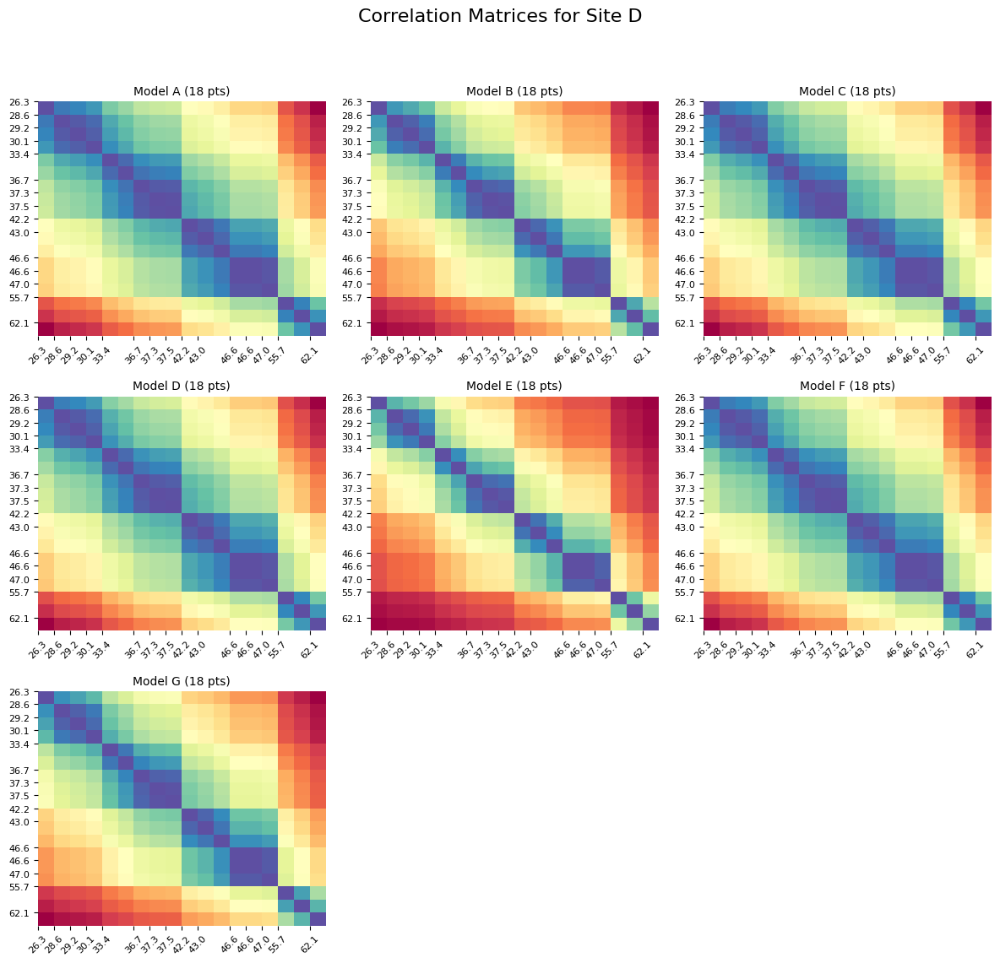

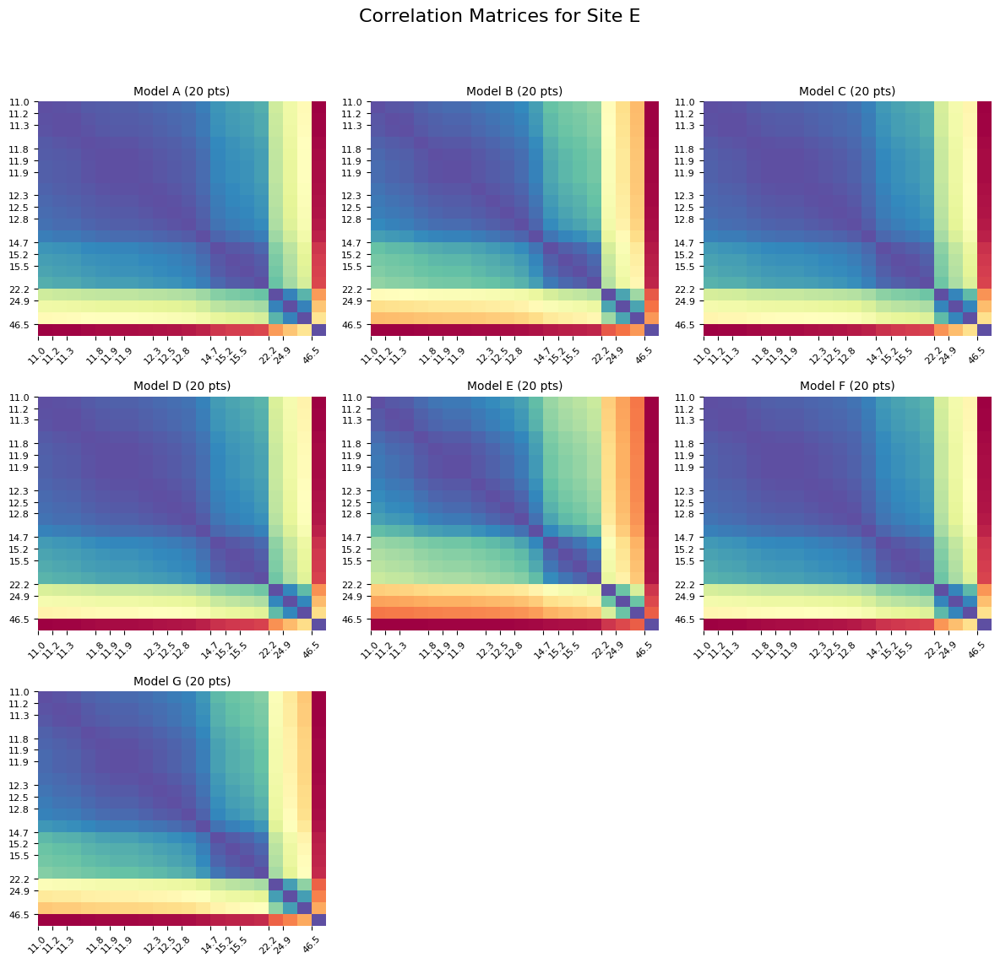

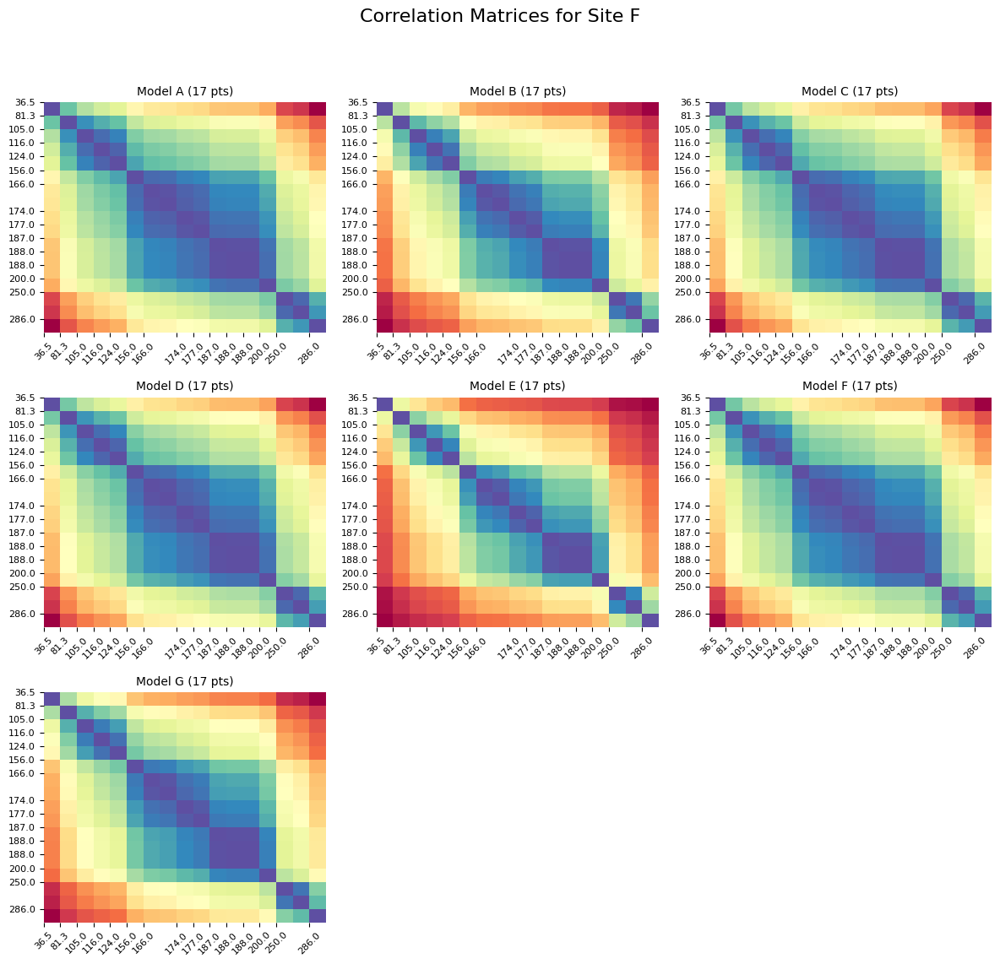

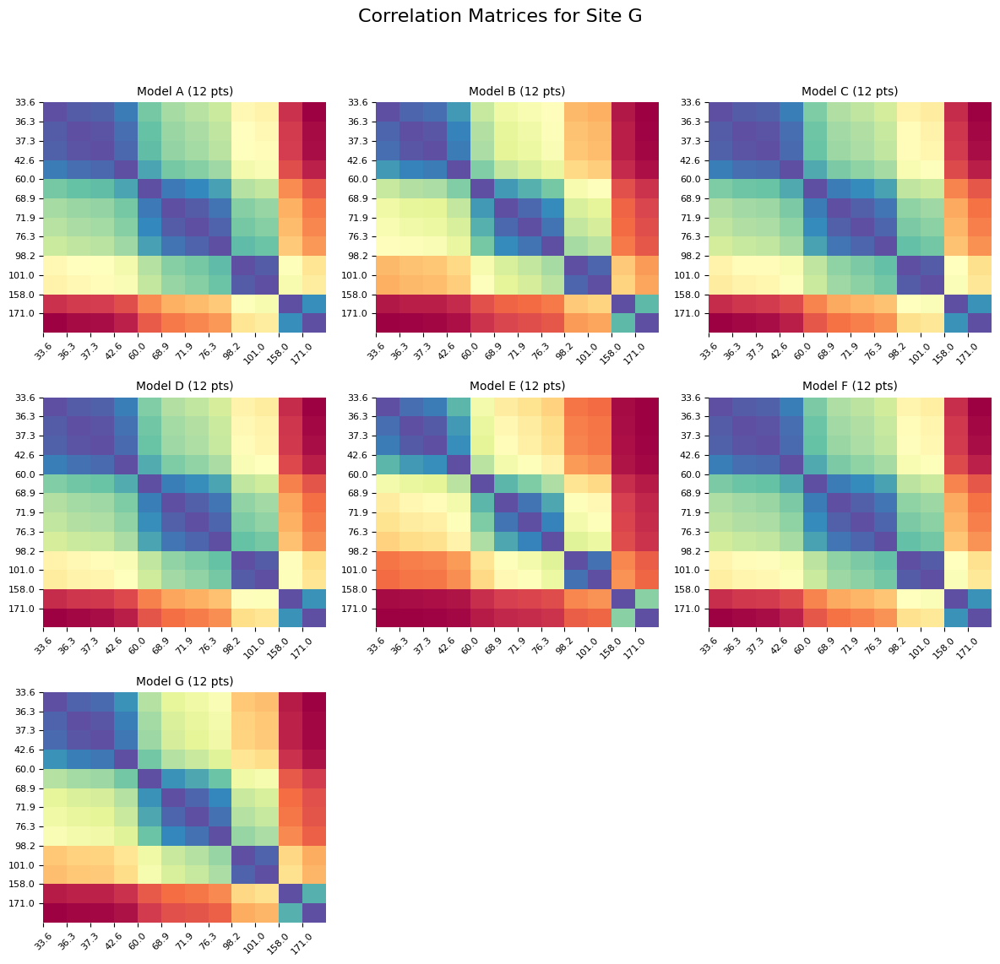

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

for id, models in correlation_matrices.items():
    num_models = len(models['num_samp'])
    num_plots = min(num_models, 7)
    n_cols = min(num_plots, 3)  # Adjusted to fit all models in one row
    n_rows = math.ceil(num_models / n_cols) 

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(4* n_cols, 4* n_rows))
    axes = axes.flatten()

    for index, (model_id, data) in enumerate(models['num_samp'].items()):
        if index >= len(axes):
            break

        cor_mat = data['cor_matrix']
        nx_trend = data['range']
        n_points = len(nx_trend)

        # Decide whether to annotate or use tick labels based on matrix size
        show_ticks = n_points <= 20
        xticks = np.round(np.sort(nx_trend), 2) if show_ticks else False
        yticks = np.round(np.sort(nx_trend), 2) if show_ticks else False
        nx_trend_sorted = np.sort(nx_trend)  # make sure x is sorted

        # Decide how many ticks to show (15 or fewer)
        n_total = len(nx_trend_sorted)
        n_ticks = min(15, n_total)

        # Get tick indices evenly spaced by index
        tick_indices = np.linspace(0, n_total - 1, n_ticks, dtype=int)
        tick_labels = np.round(nx_trend_sorted[tick_indices], 2)

        sns.heatmap(
            cor_mat,
            cbar=False,
            annot=False,  # turn on if n_points is small and needed
            cmap="Spectral",
            fmt='.2f',
            ax=axes[index],
            xticklabels=False,
            yticklabels=False
        )
        axes[index].set_title(f'Model {model_id} ({n_points} pts)', fontsize=10)
        # Set manual ticks and labels
        axes[index].set_xticks(tick_indices)
        axes[index].set_xticklabels(tick_labels, rotation=45, fontsize=8) 


        axes[index].set_yticks(tick_indices)
        axes[index].set_yticklabels(tick_labels, fontsize=8)

    # Hide any unused axes
    for j in range(index + 1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle(f'Correlation Matrices for Site {id}', fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    # Optional: save to file
    # plt.savefig(f'correlation_matrices_site_{id}.png', dpi=150)
    plt.close()


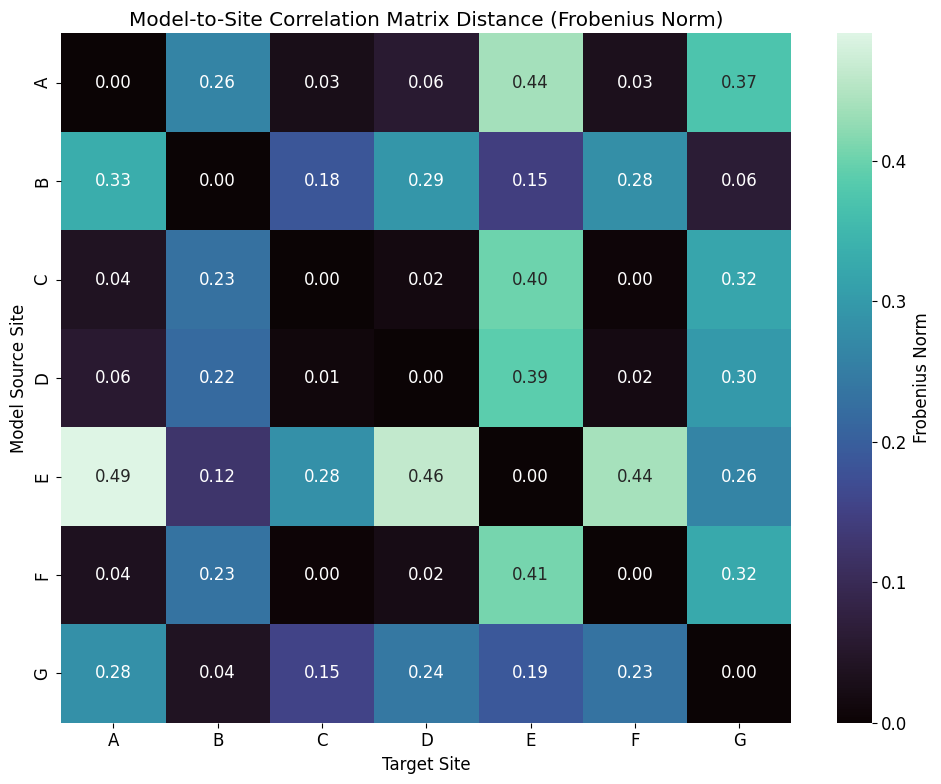

In [15]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

site_ids = list(correlation_matrices.keys())
n_sites = len(site_ids)

# Frobenius distance matrix (models vs sites)
fro_rel_matrix = np.zeros((n_sites, n_sites))

for i, model_site in enumerate(site_ids):
    for j, target_site in enumerate(site_ids):
        try:
            # Model from model_site, applied to target_site
            A = correlation_matrices[target_site]['num_samp'][model_site]['cor_matrix']

            # Reference matrix: model trained & applied on target_site itself
            B = correlation_matrices[target_site]['num_samp'][target_site]['cor_matrix']
            n = B.shape[0]

            # Option 1: normalized by sqrt(n)
            norm_diff = np.linalg.norm(A - B, 'fro') / np.sqrt(n)

            # Option 2: relative to reference matrix norm
            ref_norm = np.linalg.norm(B, 'fro')
            rel_diff = np.linalg.norm(A - B, 'fro') / ref_norm if ref_norm != 0 else np.nan

            fro_rel_matrix[i, j] = rel_diff  # use rel_diff or norm_diff

        except KeyError:
            continue  # Leave as NaN if matrix doesn't exist

plt.figure(figsize=(10, 8))
sns.heatmap(fro_rel_matrix, annot=True, fmt=".2f", cmap="mako", 
            xticklabels=site_ids, yticklabels=site_ids, cbar_kws={'label': 'Frobenius Norm'})

plt.xlabel("Target Site")
plt.ylabel("Model Source Site")
plt.title("Model-to-Site Correlation Matrix Distance (Frobenius Norm)")
plt.tight_layout()
plt.show()



# Matlab OMP calculation

## Save correlation mat for matlab

In [16]:
MATLAB_FILEPATH_ALLSAMP = MATLAB_FILEPATH + "/all_samp"
MATLAB_FILEPATH_ALLSAMP_N = MATLAB_FILEPATH_ALLSAMP + "/n_point"   
# do this to get the cor matrix
for id, models in correlation_matrices.items():
    print(f"data set: ")
    
    
    for model_id, data in models['num_samp'].items():
        # print("model_id:" , model_id)
        cor_mat = data['cor_matrix']
        nx_trend = data['range_scaled']
        
        scipy.io.savemat(f'{MATLAB_FILEPATH_ALLSAMP}/corr_samp{id}{model_id}.mat', {'cor_mat': cor_mat})
    scipy.io.savemat(f'{MATLAB_FILEPATH_ALLSAMP}/xdata_scaled_samp{id}.mat', {'xdata': nx_trend})
    
    
    
    # save n samples too
    for n, data in models['n'].items():
        # print("num_points:" , n)
        cor_mat = data['cor_matrix']
        nx_trend = data['range_scaled']
        
        scipy.io.savemat(f'{MATLAB_FILEPATH_ALLSAMP_N}/xdata_scaled_range{id}{n}.mat', {'xdata': nx_trend})
        scipy.io.savemat(f'{MATLAB_FILEPATH_ALLSAMP_N}/corr_range{id}{n}.mat', {'cor_mat': cor_mat})
        


data set: 
data set: 
data set: 
data set: 
data set: 
data set: 
data set: 


## Read OMP selection from Matlab

In [17]:
""" read sample selection and scores given arbritrary SAC range """
range_selection = {}

for id in alpha_site_id:
    range_selection[id] = {}
    for n in n_range:
        range_selection[id][n] = {}
        mat_dict = range_selection[id][n]
        mat_file = scipy.io.loadmat(f'{MATLAB_FILEPATH_ALLSAMP_N}/range{id}{n}.mat')
        mat_dict['samples'] = mat_file['A'][0]-1 # for matlab to python indexing
        mat_dict['score'] = mat_file['scores'][0]

""" read in sample selection out of grab samples we already have (permutating through each correlation matrix that was used to select samples) """
grabSamp_selection = {}

# selects site with grab samples used
for id in alpha_site_id:
    grabSamp_selection[id] = {}
    # cycle through kernel used
    for model_id in alpha_site_id:
        grabSamp_selection[id][model_id] = {}
        mat_dict = grabSamp_selection[id][model_id] 
        mat_file = scipy.io.loadmat(f'{MATLAB_FILEPATH_ALLSAMP}/samp{id}{model_id}.mat')
        mat_dict['samples'] = mat_file['A'][0]-1 # for matlab to python indexing
        mat_dict['score'] = mat_file['scores'][0]


## Plot Elbow Curve

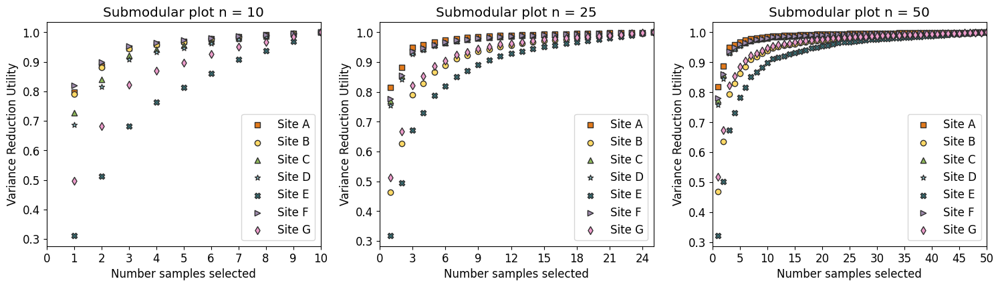

In [18]:
# Plotting the curves with subplots for each item in n_range
n_sites = len(site_ids)
n_cols = 4
n_rows = math.ceil(n_sites / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5* n_cols, 4 * n_rows))
axes = axes.flatten()

for idx, n in enumerate(n_range):
    if idx >= len(axes):
        break  # In case n_range has more than 4 items

    ax = axes[idx]
    for i, id in enumerate(alpha_site_id):
        dict_data = range_selection[id][n]
        samples = dict_data['samples']
        scores = dict_data['score']
        
        # Create a consistent x-axis since the samples is sample number, but we care about number of samples selected
        x_axis = range(1, len(samples) + 1)
        
        # Plot the curve, preserving the relationship between samples and scores
        ax.scatter(x_axis, scores, color=colr_sc[i], marker=markers[i], edgecolors='#2E2E2E', label=f'Site {id}')

    
    ax.set_xlabel('Number samples selected')
    ax.set_ylabel('Variance Reduction Utility')
    ax.set_title(f'Submodular plot n = {n}')
    ax.legend()

    # Force x-axis to have integer ticks
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))
    ax.set_xlim(0, len(samples))

# Hide any unused subplots if n_range has less than 4 items
for i in range(len(n_range), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

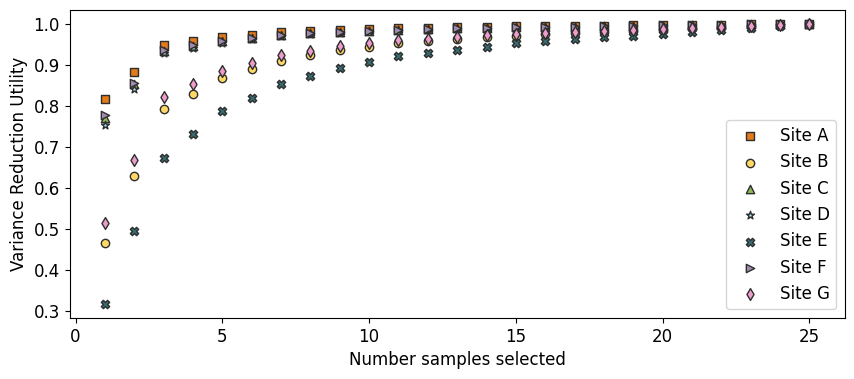

In [19]:
# plot only for n = 25

fig, ax = plt.subplots(figsize=(10, 4))

for i, id in enumerate(alpha_site_id):
    dict_data = range_selection[id][25]
    samples = dict_data['samples']
    scores = dict_data['score']
    
    # Create a consistent x-axis since the samples is sample number, but we care about number of samples selected
    x_axis = range(1, len(samples) + 1)
    
    # Plot the curve, preserving the relationship between samples and scores
    ax.scatter(x_axis, scores, color=colr_sc[i], marker=markers[i], edgecolors='#2E2E2E', label=f'Site {id}')


ax.set_xlabel('Number samples selected')
ax.set_ylabel('Variance Reduction Utility')
ax.legend()
# plt.savefig('figures/submod_n25.png', dpi=500)

## Elbows with actual field samples

A G plotted
B G plotted
C G plotted
D G plotted
E G plotted
F G plotted
G G plotted


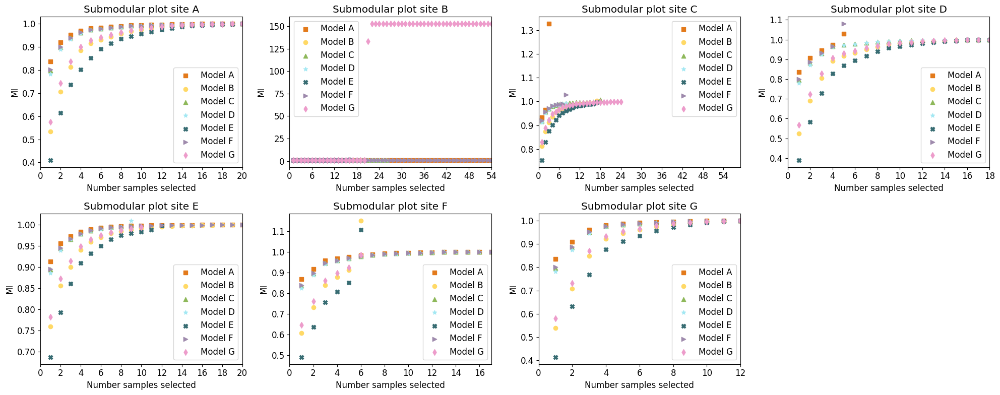

In [20]:
# Plotting the curves with subplots for each item in n_range
n_sites = len(site_ids)
n_cols = 4
n_rows = math.ceil(n_sites / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5* n_cols, 4 * n_rows))
axes = axes.flatten()

for idx, id in enumerate(alpha_site_id):
    if idx >= len(axes):
        break  # In case id_range has more than 9 items

    ax = axes[idx]
    for i, model_id in enumerate(alpha_site_id):
        dict_data = grabSamp_selection[id][model_id]
        samples = dict_data['samples']
        scores = dict_data['score']
        
        # Create a consistent x-axis since the samples is sample number, but we care about number of samples selected
        x_axis = range(1, len(samples) + 1)
        
        # Plot the curve, preserving the relationship between samples and scores
        ax.scatter(x_axis, scores, color=colr_sc[i], marker=markers[i], label=f'Model {model_id}')
    print(id, model_id, 'plotted')

    
    ax.set_xlabel('Number samples selected')
    ax.set_ylabel('MI')
    ax.set_title(f'Submodular plot site {id}')
    ax.legend()

    # Force x-axis to have integer ticks
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))
    ax.set_xlim(0, len(samples))

# Hide any unused subplots if alpha_site_id has less than 3 items
for i in range(len(alpha_site_id), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

# Error Plots
## Calculating for optimal selection
### Start at 2 samples to train and increase to 80% of available samples

In [21]:
# make array of sample order 
for idx, id in enumerate(alpha_site_id):
    if idx >= len(axes):
        break  # In case id_range has more than 9 items

    ax = axes[idx]
    for model_id in alpha_site_id:
        dict_data = grabSamp_selection[id][model_id]
        samples = dict_data['samples']
        scores = dict_data['score']

        print(samples)

[ 9 17  2 13 19 15  5  0 10 11 16 14 18  6 12  7  4  3  1  8]
[ 8 17  2 13 19 15  5 10  0 11 16 14 18  6 12  4  7  3  9  1]
[ 8 17  2 13 19 15  5 10  0 11 16 14 18  6 12  4  7  3  9  1]
[ 8 17  2 13 19 15  5 10  0 11 16 14 18  6 12  4  7  3  9  1]
[ 5 13 17  8  1 19 15 10  3 11 16 14 18  6 12  4  7  2  0  9]
[ 9 17  2 13 19 15  5  0 10 11 16 14 18  6 12  7  4  3  1  8]
[ 8 17  2 13 19 15  5 10  0 11 16 14 18  6 12  4  7  3  9  1]
[25 50 44 53 40 47 52  7 46 35 43 38 48 42 45 32 49 17 51 37 41 36 34 39
 21 13 29 30  2 19 27 10 23 33 15 11 20 24  9 31  0 26 16 22 14  5 18  8
  4 12  6  1  3  3]
[22 49 44 53 40 52 47 34 46  6 38 43 48 42 45 50 36 51 27 28 28 52 52 52
 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52
 52 52 52 52 52 52]
[24 50 44 53 40 47 52  7 46 35 43 38 48 42 32 45 49 51 16 37 41 36 34 39
 27 28 28 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52 52
 52 52 52 52 52 52]
[24 50 44 53 40 47 52  7 46 35 43 38 48 42 32 45 49 51 16 37 41 36 3

In [22]:
optimal_dictionary = {}
sample_limit_fraction = 0.8

for i, site_id in enumerate(alpha_site_id):
    # site_data = data_dictionary[site_id]
    # all model data
    baseline_data = model_dictionary[site_id]['baseline']
    # all avaialbe training samples to select from
    all_x = baseline_data['x_train']
    all_y = baseline_data['y_train']
    # What to test models on
    test_x = baseline_data['x_test']
    test_y = baseline_data['y_test']

    globalX = np.concatenate([all_x, test_x])
    globalY = np.concatenate([all_y, test_y])
    global_min_x = globalX.min()
    global_max_x = globalX.max()
    global_min_y = globalY.min()
    global_max_y = globalY.max()
          
    num_train = len(all_x)

    baseline_rmse = baseline_data['scores']['rmse']
    baseline_r2 = baseline_data['scores']['r_score']
    # Hyperparameters 
    hp = baseline_data['hyperparams']
    print(hp)
    baesline_const = hp.get('k1__constant_value', None)
    baseline_l = hp.get('k2__length_scale', None)

    # sort data
    ord = np.argsort(all_x)
    all_x_sort = all_x[ord] 
    all_y_sort = all_y[ord]


    optimal_dictionary[site_id] = { 'baseline_hyperparams': {
                                        'length_scale' : baseline_l,
                                        'constant_value' : baesline_const,
                                    },
                                    'x_sort' : all_x_sort,
                                    'y_sort' : all_y_sort,
                                    'x_test' : test_x,
                                    'y_test' : test_y,
                                    'global_x': globalX,
                                    'global_y': globalY,
                                    'baseline_rmse' : baseline_rmse,
                                    'baseline_r_score' : baseline_r2,
                                    'num_train': num_train + len(test_x),
                                    'sample_limit': num_train,
    }

    for model_id in alpha_site_id:
        opt_select = grabSamp_selection[site_id][model_id]
        opt_indices = opt_select['samples']

        print(f'length of samples: {len(opt_indices)}')
        # initialize optimal_dicitionary 
        optimal_dictionary[site_id][model_id] = {}


        # leave 20% of samples for testing
        for n in np.arange(2,num_train):
            selected_idx = opt_indices[:n]
            opt_x = all_x_sort[selected_idx]
            opt_y = all_y_sort[selected_idx]

            # print(f'length of optx: {len(opt_x)}; n: {n}, length of test: {len(test_x)}')

            # train model using only optimal samples
            SAC_pred_opt, SSC_pred_opt, std_opt, GP_score_opt, GP_logmarg_opt, GP_model, n_alpha, x_scale, y_scale  = GP(opt_x, opt_y, p) 
            SAC_pred_opt, SSC_pred_opt, std_opt, GP_score_opt, GP_logmarg_opt, GP_model, n_alpha, x_scale, y_scale = GP(
                opt_x, opt_y, p,
                SAC_test=test_x, SSC_test=test_y,
                global_min_X=global_min_x, global_max_X=global_max_x,
                global_min_Y=global_min_y, global_max_Y=global_max_y,
            )
            kernel_params = extract_kernel_hyperparams(GP_model.kernel_)
            x_min, x_range = x_scale
            x_scaled = (test_x - x_min) / x_range
             # important ypred and ydata are sorted same order wrt xdata
            ypred_scaled, std_pred_scaled = GP_model.predict(x_scaled.reshape(-1, 1), return_std=True)  

            y_min, y_range = y_scale
            ypred = ypred_scaled * y_range + y_min
            std_pred = std_pred_scaled * y_range   

            MSE_opt = np.square(np.subtract(test_y,ypred)).mean() 
            rmse_opt = math.sqrt(MSE_opt)

            r_score_opt = GP_model.score(ypred.reshape(-1, 1),test_y.reshape(-1, 1))

            optimal_dictionary[site_id][model_id][n] = {    'hyperparams': kernel_params,
                                                            'x_train' : opt_x,
                                                            'y_train' : opt_y,
                                                            'n_pred' : ypred,
                                                            'p_pred' : [SAC_pred_opt, SSC_pred_opt, std_opt],
                                                            'scores': {
                                                                'GP_score':GP_score_opt, 
                                                                'GP_logmarg':GP_logmarg_opt,
                                                                'r_score': r_score_opt, 
                                                                'rmse' : rmse_opt, 
                                                                'std': std_pred,
                                                            },
                                                            'model' : GP_model,
                                                        }

{'k1__constant_value': 0.42385624714319725, 'k2__length_scale': 1.1102089104368698}
length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

{'k1__constant_value': 0.4067109067409853, 'k2__length_scale': 0.5373491122633965}
length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__le

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__lengt

length of samples: 54


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

{'k1__constant_value': 0.714451967356554, 'k2__length_scale': 0.9771056080934764}
length of samples: 4


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__con

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 59


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

{'k1__constant_value': 0.22044561661315323, 'k2__length_scale': 0.9353193373994835}
length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__co

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__con

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 18


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

{'k1__constant_value': 0.44298750803996056, 'k2__length_scale': 0.4157015242677057}
length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__con

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__co

length of samples: 20


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__co

{'k1__constant_value': 0.44464380997231717, 'k2__length_scale': 0.9906397936042168}
length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

length of samples: 17


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

{'k1__constant_value': 0.44667451858398155, 'k2__length_scale': 0.5837297355326491}
length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__co

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

length of samples: 12


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

Site A, Model A plotted
Site A, Model B plotted
Site A, Model C plotted
Site A, Model D plotted
Site A, Model E plotted
Site A, Model F plotted
Site A, Model G plotted
Site B, Model A plotted
Site B, Model B plotted
Site B, Model C plotted
Site B, Model D plotted
Site B, Model E plotted
Site B, Model F plotted
Site B, Model G plotted
Site C, Model A plotted
Site C, Model B plotted
Site C, Model C plotted
Site C, Model D plotted
Site C, Model E plotted
Site C, Model F plotted
Site C, Model G plotted
Site D, Model A plotted
Site D, Model B plotted
Site D, Model C plotted
Site D, Model D plotted
Site D, Model E plotted
Site D, Model F plotted
Site D, Model G plotted
Site E, Model A plotted
Site E, Model B plotted
Site E, Model C plotted
Site E, Model D plotted
Site E, Model E plotted
Site E, Model F plotted
Site E, Model G plotted
Site F, Model A plotted
Site F, Model B plotted
Site F, Model C plotted
Site F, Model D plotted
Site F, Model E plotted
Site F, Model F plotted
Site F, Model G 

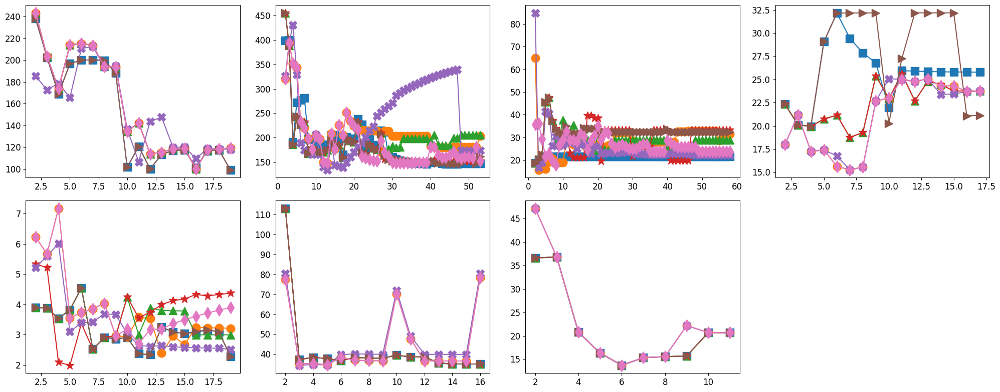

In [23]:
# Plotting the curves with subplots for each site in optimal_dictionary and random_dictionary
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5* n_cols, 4 * n_rows))
axes = axes.flatten()


for idx, site_id in enumerate(optimal_dictionary.keys()):
    if idx >= len(axes):
        break  # In case there are more than 3 sites

    ax = axes[idx]
    
    for i, model_id in enumerate(alpha_site_id):
        if model_id not in optimal_dictionary[site_id]:
            continue
        
        rmses = []
        sample_counts = []
        
        for n in sorted(optimal_dictionary[site_id][model_id].keys()):
            rmse = optimal_dictionary[site_id][model_id][n]['scores']['rmse']
            rmses.append(rmse)
            sample_counts.append(n)
        
        # Plot the curve
        ax.plot(sample_counts, rmses, linestyle='-', label=f'OMP {model_id}', marker = markers[i], markersize = '12')
        print(f'Site {site_id}, Model {model_id} plotted')

    sample_size = len(optimal_dictionary[site_id]['x_sort'])
    base_rmse = optimal_dictionary[site_id]['baseline_rmse']
    # ax.plot(range(sample_size), np.ones(sample_size)*base_rmse, color = 'red', linewidth = 3, label='baseline RMSE')

# Hide any unused subplots if optimal_dictionary has less than 3 sites
for i in range(len(optimal_dictionary), len(axes)):
    fig.delaxes(axes[i])

baseline_summary = []

for site_id in optimal_dictionary.keys():
    try:
        baseline = model_dictionary[site_id]['baseline']
        x_train_len = (baseline['x_train'])
        x_test_len = (baseline['x_test'])
        rmse = baseline['scores']['rmse']
        r2 = baseline['scores']['r_score']
        baseline_summary.append({
            'Site': site_id,
            'Train Samples': x_train_len,
            'Test Samples': x_test_len,
            'Baseline RMSE': round(rmse, 2),
            'Baseline R²': round(r2, 2)
        })
    except KeyError:
        baseline_summary.append({
            'Site': site_id,
            'Train Samples': 'Missing',
            'Test Samples': 'Missing',
            'Baseline RMSE': 'N/A',
            'Baseline R²': 'N/A'
        })

# Convert to DataFrame and print as table
baseline_df = pd.DataFrame(baseline_summary)
print("\nBaseline Model Summary:")
print(baseline_df.to_string(index=False))

plt.tight_layout()
# plt.savefig('figures/RMSE_comparison.png', dpi=500)
plt.show()



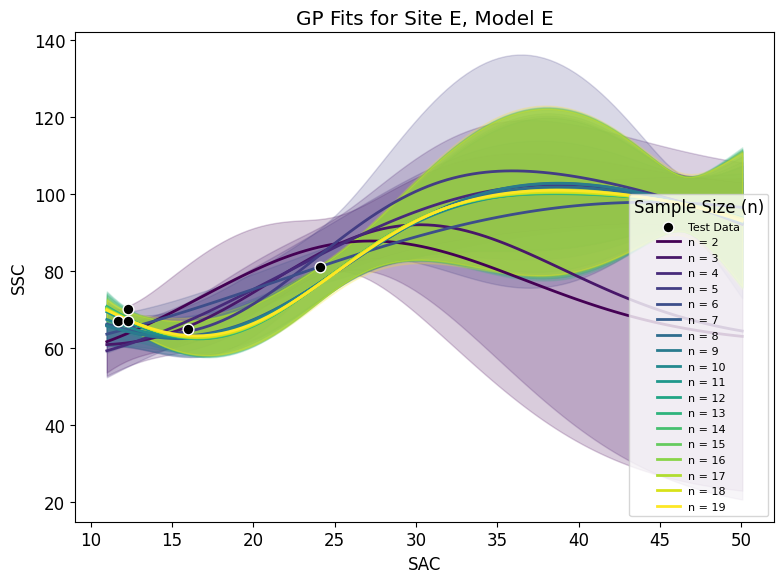

In [24]:
import matplotlib.pyplot as plt

site_id = 'E'
model_id = 'E'

fig, ax = plt.subplots(figsize=(8, 6))

# Get the global test data from the site's baseline model
baseline = model_dictionary[site_id]['baseline']
test_x = baseline['x_test']
test_y = baseline['y_test']

# Plot test data
ax.scatter(test_x, test_y, color='black', edgecolors='white', s=60, label='Test Data', zorder=5)


# Colormap for distinction
colors = plt.cm.viridis(np.linspace(0, 1, len(optimal_dictionary[site_id][model_id])))

for idx, n in enumerate(sorted(optimal_dictionary[site_id][model_id].keys())):
    fold = optimal_dictionary[site_id][model_id][n]
    SAC_pred, SSC_pred, std_pred = fold['p_pred']

    label = f"n = {n}"
    ax.plot(SAC_pred, SSC_pred, color=colors[idx], label=label, linewidth=2)
    ax.fill_between(
        SAC_pred,
        SSC_pred - 1.96 * std_pred,
        SSC_pred + 1.96 * std_pred,
        color=colors[idx],
        alpha=0.2
    )

ax.set_title(f"GP Fits for Site {site_id}, Model {model_id}")
ax.set_xlabel("SAC")
ax.set_ylabel("SSC")
ax.legend(title="Sample Size (n)", fontsize=8)
plt.tight_layout()
plt.show()


## Random calculation

In [25]:
import numpy as np

def proportional_stratified_sample(xdata, n_samples, n_bins=5):
    bins = np.linspace(np.min(xdata), np.max(xdata), n_bins + 1)
    indices = []
    
    counts = []
    bin_indices_list = []
    for i in range(n_bins):
        if i < n_bins - 1:
            bin_mask = (xdata >= bins[i]) & (xdata < bins[i+1])
        else:
            bin_mask = (xdata >= bins[i]) & (xdata <= bins[i+1])  # include max in last bin
        bin_indices = np.where(bin_mask)[0]
        bin_indices_list.append(bin_indices)
        counts.append(len(bin_indices))
    
    total_count = sum(counts)
    samples_per_bin = [int(round(n_samples * c / total_count)) for c in counts]
    
    for i in range(n_bins):
        if len(bin_indices_list[i]) <= samples_per_bin[i]:
            indices.extend(bin_indices_list[i])
            samples_per_bin[i] = 0
        else:
            chosen = np.random.choice(bin_indices_list[i], samples_per_bin[i], replace=False)
            indices.extend(chosen)
            samples_per_bin[i] = 0
    
    leftover = n_samples - len(indices)
    if leftover > 0:
        remaining_indices = list(set(range(len(xdata))) - set(indices))
        if len(remaining_indices) >= leftover:
            indices.extend(np.random.choice(remaining_indices, leftover, replace=False))
        else:
            indices.extend(remaining_indices)
    
    return np.array(indices)


In [26]:
'''i = 0
while i < r:
    ind = proportional_stratified_sample(xdata, n, n_bins=5)

    # Optional: check if range is sufficient to avoid normalization error
    if np.ptp(xdata[ind]) < 1e-8:
        print(f"Sample {i} has too small x range, resampling...")
        continue

    SAC_r[i] = xdata[ind]
    SSC_r[i] = ydata[ind]
    ind_r[i] = ind

    SAC_pred[i], SSC_pred[i], std[i], GP_score[i], GP_logmarg[i], GP_model[i], n_alpha[i], x_scale[i], y_scale[i] = GP(SAC_r[i], SSC_r[i], p)
    i += 1'''

    # r is number of runs to do, n is number of samples to make model off of, id is site id to use
# don't need to pass in data since always the same

def random_samp_models(r, n, xdata, ydata, test_x, test_y, global_min_x, global_max_x, global_min_y, global_max_y):
    seed_num = 0
    seed_lock = True

    # site_data = data_dictionary[id]
    # xdata = site_data['Samples']['SAC'].to_numpy()
    # ydata = site_data['Samples']['SSC'].to_numpy()


    if seed_lock == True:
        random.seed(seed_num)

    #initial arrays to store all runs
    SAC_r, SSC_r, ind_r, date_time_r, \
    SAC_pred, SSC_pred, std, GP_score, GP_logmarg, GP_model, n_alpha, x_scale, y_scale = ([None] * r for i in range(13))

    i=0 #create subset of data for all subsets i
    while i < r:
        # L = np.linspace(0,len(xdata)-1,len(xdata)).astype(int)
        # ind = random.sample(list(L), n)

        ind = proportional_stratified_sample(xdata, n, n_bins=5)
        # Check if range in x and y is sufficient
        if np.ptp(xdata[ind]) < 1e-8 or np.ptp(ydata[ind]) < 1e-8:
            print(f"Resampling due to low x/y range in iteration {i}")
            continue
        
        #Store run i random subset
        SAC_r[i] = xdata[ind]
        SSC_r[i] = ydata[ind]
        ind_r[i] = ind
        # print(xdata[ind])

        # GP(SAC_r[i], SSC_r[i], p)
        # SAC_pred[i], SSC_pred_opt, std_opt, GP_score_opt, GP_logmarg_opt, GP_model, n_alpha, x_scale, y_scale

        SAC_pred[i], SSC_pred[i], std[i], GP_score[i], GP_logmarg[i], GP_model[i], n_alpha[i], x_scale[i], y_scale[i] = GP(
                SAC_r[i], SSC_r[i], p,
                global_min_X=global_min_x, global_max_X=global_max_x,
                global_min_Y=global_min_y, global_max_Y=global_max_y,
                SAC_test=test_x, SSC_test=test_y,
            )

        
        i += 1

    return (SAC_r, SSC_r, ind_r, SAC_pred, SSC_pred, std, GP_score, GP_logmarg, GP_model, n_alpha, x_scale, y_scale)


In [27]:
# now we're going to make a dictionary of the different trials with different number of points
r = 20
#generalize for all sites
# sample_size = np.arange(1,21)
# sample_size = [5,10,8]
# id = 1

random_dictionary = {}

import warnings
from sklearn.exceptions import UndefinedMetricWarning, ConvergenceWarning

with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=UndefinedMetricWarning)
    warnings.filterwarnings("ignore", category=ConvergenceWarning)
    warnings.filterwarnings("ignore", category=UserWarning, message="One or more of the test scores are non-finite")


    for i, site_id in enumerate(alpha_site_id):
        random_dictionary[site_id] = {}
        print(f'site_id: {site_id}')
        
        baseline_data = model_dictionary[site_id]['baseline']
        # all avaialbe training samples to select from
        all_x = baseline_data['x_train']
        all_y = baseline_data['y_train']
        # What to test models on
        test_x = baseline_data['x_test']
        test_y = baseline_data['y_test']

        globalX = np.concatenate([all_x, test_x])
        globalY = np.concatenate([all_y, test_y])
        global_min_x = globalX.min()
        global_max_x = globalX.max()
        global_min_y = globalY.min()
        global_max_y = globalY.max()

        num_total = len(all_x)

        baseline_rmse = baseline_data['scores']['rmse']
        hp = baseline_data['hyperparams']
        baesline_const = hp.get('k1__constant_value', None)
        baseline_l = hp.get('k2__length_scale', None)

        # sort data
        ord = np.argsort(all_x)
        all_x_sort = all_x[ord] 
        all_y_sort = all_y[ord]

        #scale data


        random_dictionary[site_id] = {  'baseline_hyperparams': {
                                            'length_scale' : baseline_l,
                                            'constant_value' : baesline_const,
                                        },
                                        'x_all' : all_x_sort,
                                        'y_all' : all_y_sort,
                                        'baseline_rmse' : baseline_rmse,
                                        'num_samples' : len(all_x_sort),
                                        'num_total': num_total,
                                    }
        
        num_samp = random_dictionary[site_id]['num_samples']
        # start with using 2 samples
        sample_size = np.arange(2,num_total)

        print(f"Site {site_id}, n = {num_total} ")
        
        for n in sample_size:
            SAC_r, SSC_r, ind_r, SAC_pred_r, SSC_pred_r, std_r, GP_score_r, GP_logmarg_r, GP_model_r, n_alpha_r, x_scale_r, y_scale_r = random_samp_models(
                    r, n, 
                    all_x, all_y, 
                    test_x, test_y, 
                    global_min_x, global_max_x, 
                    global_min_y, global_max_y
                )
            print(n)
            #initalize list to hold all ypred for given number of samples 
            ypred_r = ([None] * r) 
            const_rand = ([None] * r) 
            l_rand = ([None] * r) 
            std_pred_r = ([None] * r) 
            rmse_r = ([None] * r)

            # make prediction for all data points using model and calculate rmse
            for i in range(r):
                x_train = all_x[ind_r[i]]
                y_train = all_y[ind_r[i]]
                x_min, x_range =  x_scale_r[i]
                x_scaled = (test_x - x_min) / x_range
                # print(x_test)
                # y_test = np.delete(all_y,ind_r[i]) 
                ypred_scaled, std_pred_scaled = GP_model_r[i].predict(x_scaled.reshape(-1, 1), return_std=True, return_cov=False)
                
                y_min, y_range = y_scale_r[i]
                ypred_r[i] = ypred_scaled * y_range + y_min
                std_pred_r = std_pred_scaled * y_range   
                
                MSE_r = np.square(np.subtract(test_y,ypred_r[i])).mean()     
                rmse_r[i] = math.sqrt(MSE_r) 
                kernel_params = extract_kernel_hyperparams(GP_model_r[i].kernel_)
                const_rand[i] = kernel_params.get('k1__constant_value', None)
                l_rand[i] = kernel_params.get('k2__length_scale', None)
                

            rmse_r = np.asarray(rmse_r)


            random_dictionary[site_id][n] = {   'hyperparams': {
                                                    'rbf_l' : l_rand,
                                                    'noise_l' : const_rand,
                                                },
                                                'xdata' : SAC_r,
                                                'ydata' : SSC_r,
                                                'indicies' : ind_r,
                                                'n_pred' : ypred_r,
                                                'p_pred' : [SAC_pred_r, SSC_pred_r, std_r],
                                                'score' : {
                                                    'GP_score' : GP_score_r,
                                                    'GP_logmarg' : GP_logmarg_r,
                                                    'rmse' : rmse_r, 
                                                    'std': std_pred_r,
                                                },
                                                'model' : GP_model_r,
                                                'rmse_mean' : rmse_r.mean(),
                                                'rmse_std' : rmse_r.std(),
                                                'rmse_best' : [rmse_r.min(), rmse_r.argmin()],
                                                'rmse_worst' : [rmse_r.max(), rmse_r.argmax()]
                                            }



site_id: A
Site A, n = 20 
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
site_id: B
Site B, n = 54 
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
site_id: C
Site C, n = 59 
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
site_id: D
Site D, n = 18 
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
site_id: E
Site E, n = 20 
Resampling due to low x/y range in iteration 17
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
site_id: F
Site F, n = 17 
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
site_id: G
Site G, n = 12 
2
3
4
5
6
7
8
9
10
11


## Plot error bars

[74.01949267384809, 164.65037263715192, 81.32023427620364, 76.51592400320277, 78.6299138417141, 65.89137096188801, 91.1074548001653, 84.97870670238076, 104.93009555031638, 73.75463121993486, 73.70641969857334, 79.24611959224468, 75.39646051326237, 84.23022507616459, 76.1546184966324, 91.55997215503594, 97.98537623630585, 99.60013465070166]
[593.6092181030357, 396.8595327767594, 396.0984781992362, 409.65149477490996, 326.8164365476423, 304.7700516242616, 295.8723498301861, 323.6046305604645, 236.20369217655036, 228.09164856235526, 149.9030121042451, 223.66369741282733, 169.261943723724, 208.06259893772207, 208.8944609532179, 186.4240081834717, 215.33196959377588, 214.5028026276298, 163.6963735384796, 177.14308270472768, 136.46528815821446, 145.97704333106523, 152.94249740536407, 135.99620839116628, 139.9779805138035, 133.27598841880007, 131.74802197796117, 132.2947220482981, 131.78565291668755, 131.2337950286168, 135.1022089436357, 134.02911009362717, 132.66502022502635, 132.09264332770

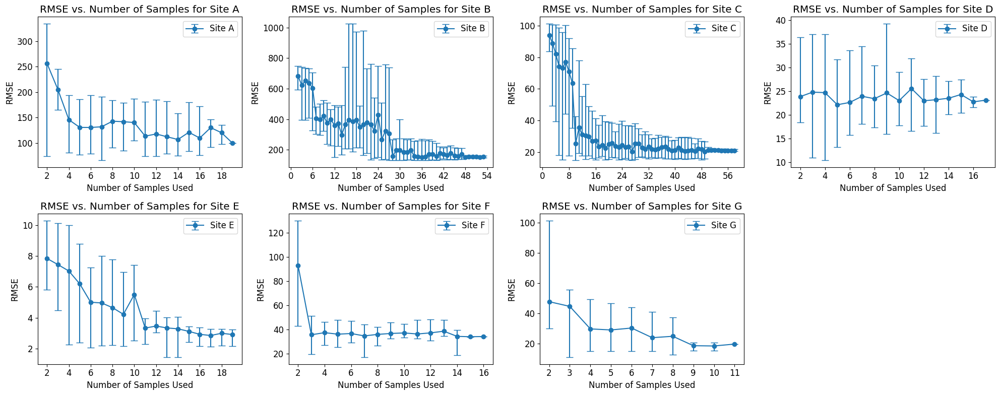

In [28]:
# Plotting the curves with subplots for each site in random_dictionary
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5* n_cols, 4 * n_rows))
axes = axes.flatten()

for idx, site_id in enumerate(random_dictionary.keys()):
    if idx >= len(axes):
        break  # In case there are more than 3 sites

    ax = axes[idx]
    
    sample_sizes = []
    rmse_means = []
    rmse_mins = []
    rmse_maxs = []

    for n in random_dictionary[site_id].keys():
        
        if isinstance(n, np.int64):
            # print(n)
            sample_sizes.append(n)
            rmse_means.append(random_dictionary[site_id][n]['rmse_mean'])
            rmse_mins.append(random_dictionary[site_id][n]['rmse_best'][0])
            rmse_maxs.append(random_dictionary[site_id][n]['rmse_worst'][0])

    # Plot the curve with error bars
    print(rmse_mins)
    ax.errorbar(sample_sizes, rmse_means, yerr=[np.array(rmse_means) - np.array(rmse_mins), np.array(rmse_maxs) - np.array(rmse_means)],
                fmt='-o', capsize=5, label=f'Site {site_id}')
    
    ax.set_xlabel('Number of Samples Used')
    ax.set_ylabel('RMSE')
    ax.set_title(f'RMSE vs. Number of Samples for Site {site_id}')
    ax.legend()

    # Force x-axis to have integer ticks
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))

# Hide any unused subplots if random_dictionary has less than 3 sites
for i in range(len(random_dictionary), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
# plt.show()



## Plot optimal and random error plots together

Site A, Model A plotted
Site A, Model B plotted
Site A, Model C plotted
Site A, Model D plotted
Site A, Model E plotted
Site A, Model F plotted
Site A, Model G plotted
Site B, Model A plotted
Site B, Model B plotted
Site B, Model C plotted
Site B, Model D plotted
Site B, Model E plotted
Site B, Model F plotted
Site B, Model G plotted
Site C, Model A plotted
Site C, Model B plotted
Site C, Model C plotted
Site C, Model D plotted
Site C, Model E plotted
Site C, Model F plotted
Site C, Model G plotted
Site D, Model A plotted
Site D, Model B plotted
Site D, Model C plotted
Site D, Model D plotted
Site D, Model E plotted
Site D, Model F plotted
Site D, Model G plotted
Site E, Model A plotted
Site E, Model B plotted
Site E, Model C plotted
Site E, Model D plotted
Site E, Model E plotted
Site E, Model F plotted
Site E, Model G plotted
Site F, Model A plotted
Site F, Model B plotted
Site F, Model C plotted
Site F, Model D plotted
Site F, Model E plotted
Site F, Model F plotted
Site F, Model G 

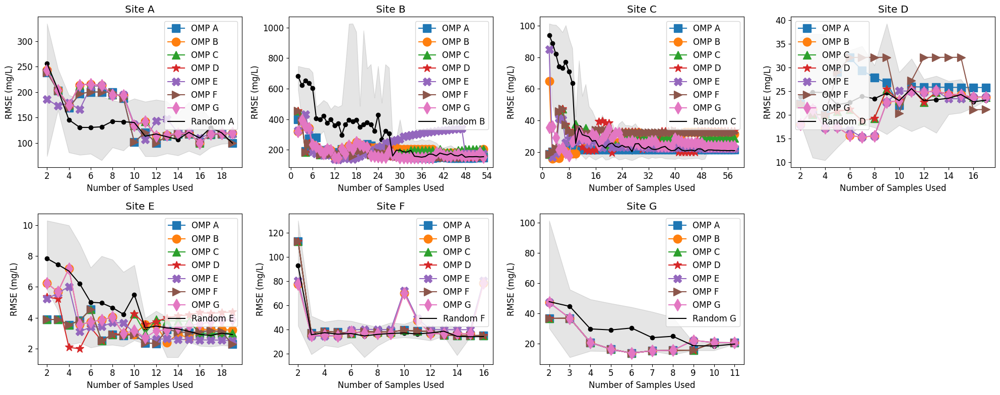

In [29]:
# Plotting the curves with subplots for each site in optimal_dictionary and random_dictionary
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5* n_cols, 4 * n_rows))
axes = axes.flatten()

for idx, site_id in enumerate(optimal_dictionary.keys()):
    if idx >= len(axes):
        break  # In case there are more than 3 sites

    ax = axes[idx]
    
    for i, model_id in enumerate(alpha_site_id):
        if model_id not in optimal_dictionary[site_id]:
            continue
        
        rmses = []
        sample_counts = []
        
        for n in sorted(optimal_dictionary[site_id][model_id].keys()):
            rmse = optimal_dictionary[site_id][model_id][n]['scores']['rmse']
            rmses.append(rmse)
            sample_counts.append(n)
        
        # Plot the curve
        ax.plot(sample_counts, rmses, linestyle='-', label=f'OMP {model_id}', marker = markers[i], markersize = '12')
        print(f'Site {site_id}, Model {model_id} plotted')

    sample_size = len(optimal_dictionary[site_id]['x_sort'])
    base_rmse = optimal_dictionary[site_id]['baseline_rmse']
    # ax.plot(range(sample_size), np.ones(sample_size)*base_rmse, color = 'red', linewidth = 3, label='baseline RMSE')

for idx, site_id in enumerate(random_dictionary.keys()):
    if idx >= len(axes):
        break  # In case there are more than 3 sites

    ax = axes[idx]
    
    sample_sizes = []
    rmse_means = []
    rmse_mins = []
    rmse_maxs = []

    for n in random_dictionary[site_id].keys():
        
        if isinstance(n, np.int64):
            # print(n)
            sample_sizes.append(n)
            rmse_means.append(random_dictionary[site_id][n]['rmse_mean'])
            rmse_mins.append(random_dictionary[site_id][n]['rmse_best'][0])
            rmse_maxs.append(random_dictionary[site_id][n]['rmse_worst'][0])

    # Plot the curve with error bars
    # print(rmse_mins)
    # ax.errorbar(sample_sizes, rmse_means, yerr=[np.array(rmse_means) - np.array(rmse_mins), np.array(rmse_maxs) - np.array(rmse_means)],
                # fmt='-o', capsize=5, label=f'Random {site_id}', color = 'black')
    # Plot the shaded error bounds
    ax.plot(sample_sizes, rmse_means, color='black',label=f'Random {site_id}')
    ax.scatter(sample_sizes, rmse_means, color='black')
    ax.fill_between(sample_sizes, rmse_mins, rmse_maxs, color='black', alpha=0.1)
    
    ax.set_xlabel('Number of Samples Used')
    ax.set_ylabel('RMSE (mg/L)')
    ax.set_title(f'Site {site_id}')
    ax.legend()

    # Force x-axis to have integer ticks
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))
# Hide any unused subplots if optimal_dictionary has less than 3 sites
for i in range(len(optimal_dictionary), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
# plt.savefig('figures/RMSE_comparison.png', dpi=500)
plt.show()



# Active Learning

In [40]:
from pathlib import Path
import time
# import scipy.io
# import shutil

# ==== Config ====
PROJECT_ROOT = Path.cwd()
BASE_DIR = PROJECT_ROOT
DATASET_NAME = "GVR_LISST"  # or "GVR_LISST"
DATASET_DIR = BASE_DIR / DATASET_NAME
FLAGS_DIR = BASE_DIR / "flags"
SELECTION_HISTORY_DIR = DATASET_DIR / "selection_history"

# Create directories
FLAGS_DIR.mkdir(exist_ok=True, parents=True)
DATASET_DIR.mkdir(exist_ok=True, parents=True)
SELECTION_HISTORY_DIR.mkdir(exist_ok=True, parents=True)

# File flags
FLAG_PYTHON_READY = FLAGS_DIR / "ready_for_matlab.txt"
FLAG_MATLAB_READY = FLAGS_DIR / "ready_for_python.txt"

# Sample tracking
sample_limit_fraction = 0.8
num_select_each_round = 3
adaptive_learning = {}

def wait_for_file(path):
    print(f"⏳ Waiting for: {path}")
    while not path.exists():
        time.sleep(3)
    print(f"✅ Found: {path}")

def remove_file(path):
    if path.exists():
        path.unlink()

In [45]:
selection_history = {site_id: [] for site_id in alpha_site_id}
num_step = 5

def adaptive_sample_loop():
    for site_id in alpha_site_id:
        baseline_data = model_dictionary[site_id]['baseline']
        all_x = baseline_data['x_train']
        all_y = baseline_data['y_train']
        test_x = baseline_data['x_test']
        test_y = baseline_data['y_test']

        globalX = np.concatenate([all_x, test_x])
        globalY = np.concatenate([all_y, test_y])
        global_min_x, global_max_x = globalX.min(), globalX.max()
        global_min_y, global_max_y = globalY.min(), globalY.max()
        num_train = len(all_x)

        baseline_rmse = baseline_data['scores']['rmse']
        hp = baseline_data['hyperparams']
        baesline_const = hp.get('k1__constant_value', None)
        baseline_l = hp.get('k2__length_scale', None)

        print(f"\n🔁 Site {site_id}: max {num_train} samples to be used.")
        all_x_sort = all_x[np.argsort(all_x)]
        all_y_sort = all_y[np.argsort(all_x)]

        # Save xdata once for MATLAB
        scipy.io.savemat(DATASET_DIR / f"xdata_samp{site_id}.mat", {"xdata": all_x_sort.reshape(-1, 1)})

        adaptive_learning[site_id] = {
            'sample_limit': num_train,
            'x_sort': all_x_sort,
            'y_sort': all_y_sort,
            'baseline_rmse': baseline_rmse,
            'baseline_hyperparams': hp,
        }

        for model_id in alpha_site_id:
            adaptive_learning[site_id][model_id] = {}
            current_selected = []

            while len(current_selected) + num_step <= num_train:
                n_used = len(current_selected)
                print(f"🔢 {site_id}-{model_id} | Samples used: {n_used}")

                # Compute kernel matrix using current hyperparameters
                hp = adaptive_learning[site_id][model_id][n_used]['hyperparams'] if n_used > 0 else model_dictionary[model_id]['baseline']['hyperparams']
                # l, const_l = extract_kernel_hyperparams(ker)
                const_l = hp.get('k1__constant_value', None)
                l = hp.get('k2__length_scale', None)

                print(l, const_l)

                kern = np.zeros((num_train, num_train))
                for i, x in enumerate(all_x_sort):
                    for j, y in enumerate(all_x_sort):
                        kern[i, j] = const_rbf_kernel(x, y, l, const_l)

                cor_mat = cov_to_cor(kern)

                # Save correlation matrix and selected x indices
                corr_fname = f"corr_samp{site_id}{model_id}_{n_used}.mat"
                xdata_fname = f"xselect_samp{site_id}{model_id}_{n_used}.mat"
                scipy.io.savemat(DATASET_DIR / corr_fname, {"cor_mat": cor_mat})
                scipy.io.savemat(DATASET_DIR / xdata_fname, {"xdata": np.array(current_selected) + 1})

                print("📤 Wrote correlation and selection files. Now run MATLAB.")
                
                # === MANUAL PAUSE ===
                expected_matfile = DATASET_DIR / f"mat_xselect_samp{site_id}{model_id}_{n_used + num_step}.mat"
                while not expected_matfile.exists():
                    print(f"⏳ Waiting for {expected_matfile.name} ...")
                    time.sleep(1)

                mat_data = scipy.io.loadmat(expected_matfile)
                new_selected = (mat_data["A"][0] - 1).astype(int)
                current_selected += [i for i in new_selected if i not in current_selected]
                selection_history[site_id] = current_selected.copy()

                # Train GP
                x_train, y_train = all_x[current_selected], all_y[current_selected]
                SAC_pred, SSC_pred, std_p_pred, score, log_marg, GP_model, alpha, x_scale, y_scale = GP(
                    x_train, y_train, p,
                    SAC_test=test_x, SSC_test=test_y,
                    global_min_X=global_min_x, global_max_X=global_max_x,
                    global_min_Y=global_min_y, global_max_Y=global_max_y,
                )

                hp_new = extract_kernel_hyperparams(GP_model.kernel_)
                const_new = hp_new.get('k1__constant_value', None)
                l_new = hp_new.get('k2__length_scale', None)

                x_test_scaled = (test_x - global_min_x) / (global_max_x - global_min_x)
                ypred_scaled, std_pred_scaled = GP_model.predict(x_test_scaled.reshape(-1, 1), return_std=True)
                ypred = ypred_scaled * (global_max_y - global_min_y) + global_min_y
                std_pred = std_pred_scaled * (global_max_y - global_min_y)
                rmse = np.sqrt(np.mean((test_y - ypred) ** 2))
                r_score = GP_model.score(ypred.reshape(-1, 1), test_y.reshape(-1, 1))

                adaptive_learning[site_id][model_id][len(current_selected)] = {
                    'hyperparams': hp_new,
                    'cor_matrix': cor_mat,
                    'x_train': x_train,
                    'y_train': y_train,
                    'x_test': test_x,
                    'y_test': test_y,
                    'n_pred': ypred,
                    'p_pred': [SAC_pred, SSC_pred, std_p_pred],
                    'scores': {'rmse': rmse, 'std': std_pred},
                    'model': GP_model
                }

                np.save(SELECTION_HISTORY_DIR / f"{site_id}_selection.npy", np.array(current_selected))
                print(f"📈 Selected ({len(current_selected)}): {new_selected.tolist()}")

            print(f"✅ Done with model {model_id}")
        print(f"✅ Done with site {site_id}")

adaptive_sample_loop()



🔁 Site A: max 20 samples to be used.
🔢 A-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

📈 Selected (5): [8, 1, 3, 5, 17]
🔢 A-A | Samples used: 5
0.7844094519066291 0.5752501384626679
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4]
🔢 A-A | Samples used: 10
0.990845143073846 0.6263967391738984
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regres

📈 Selected (15): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16]
🔢 A-A | Samples used: 15
1.1751704242570151 0.8
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16, 13, 11, 15, 19, 10]
✅ Done with model A
🔢 A-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [8, 0, 2, 4, 6]
🔢 A-B | Samples used: 5
1.0939200744199222 0.7105908549605764
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5]
🔢 A-B | Samples used: 10
0.8606296543770643 0.26399987853856166
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (15): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5, 17, 12, 14, 10, 15]
🔢 A-B | Samples used: 15
0.9109215859390758 0.2259981216919944
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5, 17, 12, 14, 10, 15, 18, 13, 11, 16, 19]
✅ Done with model B
🔢 A-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

📈 Selected (5): [8, 1, 3, 5, 17]
🔢 A-C | Samples used: 5
0.7844094519066291 0.5752501384626679
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4]
🔢 A-C | Samples used: 10
0.990845143073846 0.6263967391738984
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

📈 Selected (15): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16]
🔢 A-C | Samples used: 15
1.1751704242570151 0.8
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16, 13, 11, 15, 19, 10]
✅ Done with model C
🔢 A-D | Samples used: 0
0.9353193373994835 0.22044561661315323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [8, 1, 3, 5, 17]
🔢 A-D | Samples used: 5
0.7844094519066291 0.5752501384626679
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4]
🔢 A-D | Samples used: 10
0.990845143073846 0.6263967391738984
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

📈 Selected (15): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16]
🔢 A-D | Samples used: 15
1.1751704242570151 0.8
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16, 13, 11, 15, 19, 10]
✅ Done with model D
🔢 A-E | Samples used: 0
0.4157015242677057 0.44298750803996056
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [8, 0, 2, 4, 5]
🔢 A-E | Samples used: 5
0.6933268118883403 0.5243114487774381
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

📈 Selected (10): [8, 0, 2, 4, 5, 9, 1, 3, 7, 17]
🔢 A-E | Samples used: 10
0.4441652780869668 0.4057146610023271
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [8, 0, 2, 4, 5, 9, 1, 3, 7, 17, 6, 10, 11, 12, 13]
🔢 A-E | Samples used: 15
0.8915365708393806 0.2492436097416519
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regre

📈 Selected (20): [8, 0, 2, 4, 5, 9, 1, 3, 7, 17, 6, 10, 11, 12, 13, 18, 14, 15, 16, 19]
✅ Done with model E
🔢 A-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [8, 1, 3, 5, 17]
🔢 A-F | Samples used: 5
0.7844094519066291 0.5752501384626679
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

📈 Selected (10): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4]
🔢 A-F | Samples used: 10
0.990845143073846 0.6263967391738984
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16]
🔢 A-F | Samples used: 15
1.1751704242570151 0.8
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regres

📈 Selected (20): [8, 1, 3, 5, 17, 9, 0, 2, 7, 4, 18, 6, 12, 14, 16, 13, 11, 15, 19, 10]
✅ Done with model F
🔢 A-G | Samples used: 0
0.5837297355326491 0.44667451858398155
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [8, 0, 2, 4, 6]
🔢 A-G | Samples used: 5
1.0939200744199222 0.7105908549605764
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  

📈 Selected (10): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5]
🔢 A-G | Samples used: 10
0.8606296543770643 0.26399987853856166
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5, 17, 12, 14, 10, 15]
🔢 A-G | Samples used: 15
0.9109215859390758 0.2259981216919944
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [8, 0, 2, 4, 6, 9, 1, 3, 7, 5, 17, 12, 14, 10, 15, 18, 13, 11, 16, 19]
✅ Done with model G
✅ Done with site A

🔁 Site B: max 54 samples to be used.
🔢 B-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [4, 13, 27, 19, 22]
🔢 B-A | Samples used: 5
0.3 0.8
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (10): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6]
🔢 B-A | Samples used: 10
0.3 0.22119316712300918
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18]
🔢 B-A | Samples used: 15
0.3561536318540104 0.09617340059084956
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/

📈 Selected (20): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25]
🔢 B-A | Samples used: 20
0.789758228969644 0.2600379697765361
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31]
🔢 B-A | Samples used: 25
0.8493378655732055 0.2907389407978648
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (30): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31, 32, 24, 20, 10, 34]
🔢 B-A | Samples used: 30
0.9845776877375403 0.3579685119188941
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (35): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31, 32, 24, 20, 10, 34, 11, 33, 23, 29, 30]
🔢 B-A | Samples used: 35
0.9382183677666432 0.3258640550905935
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (40): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31, 32, 24, 20, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40]
🔢 B-A | Samples used: 40
0.9970320607775138 0.3621367369313792
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (45): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31, 32, 24, 20, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44]
🔢 B-A | Samples used: 45
1.2003520290211376 0.4918597078443401
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [4, 13, 27, 19, 22, 28, 3, 1, 12, 6, 2, 0, 7, 5, 18, 8, 14, 21, 16, 25, 9, 15, 17, 26, 31, 32, 24, 20, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49]
✅ Done with model A
🔢 B-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [3, 27, 7, 13, 0]
🔢 B-B | Samples used: 5
0.3 0.27686076316662134
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6]
🔢 B-B | Samples used: 10
0.3 0.20721116690879046
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21]
🔢 B-B | Samples used: 15
0.7634004368534018 0.3619961494558195
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25]
🔢 B-B | Samples used: 20
0.949064221569274 0.34814729898743196
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (25): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20]
🔢 B-B | Samples used: 25
0.9487531864201859 0.3490385017623538
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34]
🔢 B-B | Samples used: 30
0.8187408647976643 0.2603805473990067
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30]
🔢 B-B | Samples used: 35
0.828911198676755 0.261819260985555
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40]
🔢 B-B | Samples used: 40
0.8796135299530523 0.29380787580240464
📤 Wrote correlation and se

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (45): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44]
🔢 B-B | Samples used: 45
1.0586311036671983 0.4019063181235992
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49]
✅ Done with model B
🔢 B-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [4, 13, 27, 19, 8]
🔢 B-C | Samples used: 5
0.4434587162685113 0.5248460334542323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

📈 Selected (10): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7]
🔢 B-C | Samples used: 10
0.44664412793197666 0.2041851987809662
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14]
🔢 B-C | Samples used: 15
0.7237469315432548 0.3174551956501637
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25]
🔢 B-C | Samples used: 20
0.7997658713267182 0.25036208157533507
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20]
🔢 B-C | Samples used: 25
0.796134956409457 0.25831829459270345
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34]
🔢 B-C | Samples used: 30
1.2641496006449235 0.535336624423693
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34, 11, 33, 23, 29, 30]
🔢 B-C | Samples used: 35
1.2842576852109975 0.5419908588150789
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [4, 13, 27, 19, 8, 3, 28, 1, 12

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

📈 Selected (10): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7]
🔢 B-D | Samples used: 10
0.44664412793197666 0.2041851987809662
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14]
🔢 B-D | Samples used: 15
0.7237469315432548 0.3174551956501637
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25]
🔢 B-D | Samples used: 20
0.7997658713267182 0.25036208157533507
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20]
🔢 B-D | Samples used: 25
0.796134956409457 0.25831829459270345
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34]
🔢 B-D | Samples used: 30
1.2641496006449235 0.535336624423693
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34, 11, 33, 23, 29, 30]
🔢 B-D | Samples used: 35
1.2842576852109975 0.5419908588150789
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [4, 13, 27, 19, 8, 3, 28, 1, 12

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6]
🔢 B-E | Samples used: 10
0.3 0.20721116690879499
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21]
🔢 B-E | Samples used: 15
0.850678425364516 0.4085363807761832
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25]
🔢 B-E | Samples used: 20
0.800255754673609 0.25869585297899006
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20]
🔢 B-E | Samples used: 25
1.199607016578219 0.5049749149244216
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (30): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 10, 24, 32, 34]
🔢 B-E | Samples used: 30
0.8187408647976636 0.260380547399006
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 10, 24, 32, 34, 11, 33, 23, 29, 30]
🔢 B-E | Samples used: 35
0.8289111986767553 0.2618192609855553
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 10, 24, 32, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40]
🔢 B-E | Samples used: 40
0.8796135299530511 0.2938078758024035
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (45): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 10, 24, 32, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44]
🔢 B-E | Samples used: 45
1.1273263172496037 0.4444504440775919
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [3, 27, 1, 13, 7, 28, 4, 0, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 10, 24, 32, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49]
✅ Done with model E
🔢 B-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [4, 13, 27, 19, 8]
🔢 B-F | Samples used: 5
0.4434587162685113 0.5248460334542323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

📈 Selected (10): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7]
🔢 B-F | Samples used: 10
0.44664412793197666 0.2041851987809662
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14]
🔢 B-F | Samples used: 15
0.7237469315432548 0.3174551956501637
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25]
🔢 B-F | Samples used: 20
0.7997658713267182 0.25036208157533507
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (25): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20]
🔢 B-F | Samples used: 25
0.796134956409457 0.25831829459270345
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34]
🔢 B-F | Samples used: 30
1.2641496006449235 0.535336624423693
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34, 11, 33, 23, 29, 30]
🔢 B-F | Samples used: 35
1.2842576852109975 0.5419908588150789
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [4, 13, 27, 19, 8, 3, 28, 1, 12, 7, 2, 6, 0, 18, 14, 5, 15, 22, 9, 25, 21, 16, 26, 31, 20, 17, 32, 24, 10, 34, 11, 33, 23, 29, 30, 38, 35, 40, 42, 43]
🔢 B-F | Samples used: 40
0.934977910354292 0.3271620100243049
📤 Wrote correlation and sel

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6]
🔢 B-G | Samples used: 10
0.3 0.20721116690879046
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21]
🔢 B-G | Samples used: 15
0.7634004368534018 0.3619961494558195
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25]
🔢 B-G | Samples used: 20
0.949064221569274 0.34814729898743196
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20]
🔢 B-G | Samples used: 25
0.9487531864201859 0.3490385017623538
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (30): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34]
🔢 B-G | Samples used: 30
0.8187408647976643 0.2603805473990067
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30]
🔢 B-G | Samples used: 35
0.828911198676755 0.261819260985555
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40]
🔢 B-G | Samples used: 40
0.8796135299530523 0.29380787580240464
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (45): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44]
🔢 B-G | Samples used: 45
1.0586311036671983 0.4019063181235992
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [3, 27, 7, 13, 0, 28, 4, 1, 12, 6, 2, 5, 19, 14, 21, 8, 18, 15, 22, 25, 9, 16, 26, 31, 20, 17, 24, 32, 10, 34, 11, 33, 23, 29, 30, 38, 35, 36, 37, 40, 39, 41, 42, 43, 44, 45, 46, 47, 48, 49]
✅ Done with model G
✅ Done with site B

🔁 Site C: max 59 samples to be used.
🔢 C-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [13, 2, 35, 25, 40]
🔢 C-A | Samples used: 5
0.3 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (10): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55]
🔢 C-A | Samples used: 10
0.7013167252115536 0.5168659102336811
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (15): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34]
🔢 C-A | Samples used: 15
0.5811837505224355 0.5720750863439581
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6]
🔢 C-A | Samples used: 20
0.6409588368636574 0.5203071290535576
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (25): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56]
🔢 C-A | Samples used: 25
0.8503161246221279 0.3825404417163512
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56, 10, 24, 5, 36, 18]
🔢 C-A | Samples used: 30
0.8052152426326553 0.3326284341614149
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (35): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56, 10, 24, 5, 36, 18, 9, 21, 33, 27, 39]
🔢 C-A | Samples used: 35
0.8666379020831944 0.5032085416126155
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (40): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56, 10, 24, 5, 36, 18, 9, 21, 33, 27, 39, 19, 32, 45, 38, 30]
🔢 C-A | Samples used: 40
0.7627658983025111 0.47966681226660746
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56, 10, 24, 5, 36, 18, 9, 21, 33, 27, 39, 19, 32, 45, 38, 30, 44, 31, 28, 47, 42]
🔢 C-A | Samples used: 45
0.7703803116533166 0.48842364160632584
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 17, 6, 11, 1, 20, 26, 56, 10, 24, 5, 36, 18, 9, 21, 33, 27, 39, 19, 32, 45, 38, 30, 44, 31, 28, 47, 42, 46, 41, 43, 37, 29]
🔢 C-A | Samples used: 50
0.7829813510014052 0.49613723782856445
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (55): [13, 2, 35, 25, 40, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (10): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55]
🔢 C-B | Samples used: 10
0.3 0.2283907368330277
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56]
🔢 C-B | Samples used: 15
0.6067158795420609 0.5638275850818117
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26]
🔢 C-B | Samples used: 20
0.6274565996717592 0.5397981405497398
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34]
🔢 C-B | Samples used: 25
1.1457232728632099 0.6589966144084224
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (30): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39]
🔢 C-B | Samples used: 30
0.8415244283492131 0.4705589482668573
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44]
🔢 C-B | Samples used: 35
1.0748296026481818 0.700711421598627
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (40): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44, 19, 6, 32, 38, 46]
🔢 C-B | Samples used: 40
0.7733111436103635 0.4808898904354943
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44, 19, 6, 32, 38, 46, 21, 31, 47, 42, 41]
🔢 C-B | Samples used: 45
0.7781539165134915 0.4895622895628272
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44, 19, 6, 32, 38, 46, 21, 31, 47, 42, 41, 30, 28, 43, 37, 49]
🔢 C-B | Samples used: 50
0.8649347765507296 0.5655314860267964
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (55): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12,

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55]
🔢 C-C | Samples used: 10
0.7295661698337542 0.3574469022263827
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34]
🔢 C-C | Samples used: 15
0.7851206316544661 0.5965783627838854
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56]
🔢 C-C | Samples used: 20
0.7790468838818879 0.6222970752035663
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33]
🔢 C-C | Samples used: 25
0.8065678397828984 0.6251194068659416
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32]
🔢 C-C | Samples used: 30
0.7916249571516702 0.5998315607309717
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (35): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40]
🔢 C-C | Samples used: 35
0.8384736266045686 0.47225888336147914
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38]
🔢 C-C | Samples used: 40
0.8126538887034369 0.5234235028584917
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38, 19, 30, 46, 41, 43]
🔢 C-C | Samples used: 45
0.773870278311483 0.4860244074147457
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55]
🔢 C-D | Samples used: 10
0.7295661698337542 0.3574469022263827
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34]
🔢 C-D | Samples used: 15
0.7851206316544661 0.5965783627838854
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56]
🔢 C-D | Samples used: 20
0.7790468838818879 0.6222970752035663
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33]
🔢 C-D | Samples used: 25
0.8065678397828984 0.6251194068659416
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32]
🔢 C-D | Samples used: 30
0.7916249571516702 0.5998315607309717
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40]
🔢 C-D | Samples used: 35
0.8384736266045686 0.47225888336147914
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (40): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38]
🔢 C-D | Samples used: 40
0.8126538887034369 0.5234235028584917
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38, 19, 30, 46, 41, 43]
🔢 C-D | Samples used: 45
0.773870278311483 0.4860244074147457
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38, 19, 30, 46, 41, 43, 28, 47, 42, 37, 29]
🔢 C-D | Samples used: 50
0.8642944417747462 0.5697926369597814
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (55): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (10): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55]
🔢 C-E | Samples used: 10
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55, 14, 34, 44, 39, 56]
🔢 C-E | Samples used: 15
1.1173557091093167 0.6050854329752902
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (20): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55, 14, 34, 44, 39, 56, 12, 24, 3, 33, 38]
🔢 C-E | Samples used: 20
0.7790150200210951 0.47074182069961923
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55, 14, 34, 44, 39, 56, 12, 24, 3, 33, 38, 16, 4, 25, 8, 36]
🔢 C-E | Samples used: 25
0.7745961965638127 0.47651843183468806
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55, 14, 34, 44, 39, 56, 12, 24, 3, 33, 38, 16, 4, 25, 8, 36, 17, 0, 26, 9, 32]
🔢 C-E | Samples used: 30
0.814680211490691 0.5102498315334382
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [13, 2, 7, 20, 23, 15, 35, 45, 40, 55, 14, 34, 44, 39, 56, 12, 24, 3, 33, 38, 16, 4, 25, 8, 36, 17, 0, 26, 9, 32, 11, 22, 1, 31, 27]
🔢 C-E | Samples used: 35
0.8196595068809909 0.5187741944606772
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [13, 2, 7, 20

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (10): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55]
🔢 C-F | Samples used: 10
0.7295661698337542 0.3574469022263827
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34]
🔢 C-F | Samples used: 15
0.7851206316544661 0.5965783627838854
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56]
🔢 C-F | Samples used: 20
0.7790468838818879 0.6222970752035663
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33]
🔢 C-F | Samples used: 25
0.8065678397828984 0.6251194068659416
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (30): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32]
🔢 C-F | Samples used: 30
0.7916249571516702 0.5998315607309717
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40]
🔢 C-F | Samples used: 35
0.8384736266045686 0.47225888336147914
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (40): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38]
🔢 C-F | Samples used: 40
0.8126538887034369 0.5234235028584917
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38, 19, 30, 46, 41, 43]
🔢 C-F | Samples used: 45
0.773870278311483 0.4860244074147457
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (50): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 0, 22, 36, 56, 17, 1, 25, 9, 33, 11, 21, 5, 26, 32, 10, 20, 27, 45, 40, 18, 6, 31, 44, 38, 19, 30, 46, 41, 43, 28, 47, 42, 37, 29]
🔢 C-F | Samples used: 50
0.8642944417747462 0.5697926369597814
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (55): [13, 2, 24, 35, 39, 3, 14, 7, 16, 55, 15, 4, 23, 8, 34, 12, 

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (10): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55]
🔢 C-G | Samples used: 10
0.3 0.2283907368330277
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56]
🔢 C-G | Samples used: 15
0.6067158795420609 0.5638275850818117
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26]
🔢 C-G | Samples used: 20
0.6274565996717592 0.5397981405497398
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (25): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34]
🔢 C-G | Samples used: 25
1.1457232728632099 0.6589966144084224
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (30): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39]
🔢 C-G | Samples used: 30
0.8415244283492131 0.4705589482668573
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (35): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44]
🔢 C-G | Samples used: 35
1.0748296026481818 0.700711421598627
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (40): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44, 19, 6, 32, 38, 46]
🔢 C-G | Samples used: 40
0.7733111436103635 0.4808898904354943
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (45): [13, 2, 23, 7, 8, 15, 35, 45, 40, 55, 3, 14, 16, 9, 56, 12, 0, 22, 17, 26, 11, 1, 20, 25, 34, 10, 24, 33, 4, 39, 18, 5, 27, 36, 44, 19, 6, 32, 38, 46, 21, 31, 47, 42, 41]
🔢 C-G 

/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (10): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5]
🔢 D-A | Samples used: 10
1.1451974435524337 0.3434841477812344
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5, 14, 6, 3, 11, 16]
✅ Done with model A
🔢 D-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (5): [12, 7, 2, 10, 5]
🔢 D-B | Samples used: 5
0.3 0.8
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9]
🔢 D-B | Samples used: 10
0.8707095127422357 0.15259961940396874
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (15): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9, 14, 3, 11, 4, 0]
✅ Done with model B
🔢 D-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [12, 7, 2, 10, 4]
🔢 D-C | Samples used: 5
1.1890192041472645 0.35689166506938264
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (10): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5]
🔢 D-C | Samples used: 10
1.1451974435524337 0.3434841477812344
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5, 14, 6, 3, 11, 16]
✅ Done with model C
🔢 D-D | Samples used: 0
0.9353193373994835 0.22044561661315323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (5): [12, 7, 2, 10, 4]
🔢 D-D | Samples used: 5
1.1890192041472645 0.35689166506938264
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5]
🔢 D-D | Samples used: 10
1.1451974435524337 0.3434841477812344
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (15): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5, 14, 6, 3, 11, 16]
✅ Done with model D
🔢 D-E | Samples used: 0
0.4157015242677057 0.44298750803996056
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [12, 7, 2, 10, 5]
🔢 D-E | Samples used: 5
0.3 0.8
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (10): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9]
🔢 D-E | Samples used: 10
0.8707095127422357 0.15259961940396874
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9, 14, 3, 11, 4, 0]
✅ Done with model E
🔢 D-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (5): [12, 7, 2, 10, 4]
🔢 D-F | Samples used: 5
1.1890192041472645 0.35689166506938264
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5]
🔢 D-F | Samples used: 10
1.1451974435524337 0.3434841477812344
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (15): [12, 7, 2, 10, 4, 13, 8, 1, 9, 5, 14, 6, 3, 11, 16]
✅ Done with model F
🔢 D-G | Samples used: 0
0.5837297355326491 0.44667451858398155
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/

📈 Selected (5): [12, 7, 2, 10, 5]
🔢 D-G | Samples used: 5
0.3 0.8
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (10): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9]
🔢 D-G | Samples used: 10
0.8707095127422357 0.15259961940396874
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [12, 7, 2, 10, 5, 13, 8, 1, 6, 9, 14, 3, 11, 4, 0]
✅ Done with model G
✅ Done with site D

🔁 Site E: max 20 samples to be used.
🔢 E-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression

📈 Selected (5): [5, 13, 17, 1, 10]
🔢 E-A | Samples used: 5
0.3 0.2990909463637593
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [5, 13, 17, 1, 10, 6, 2, 8, 14, 0]
🔢 E-A | Samples used: 10
0.3485172573711575 0.06512858467112084
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/

📈 Selected (15): [5, 13, 17, 1, 10, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15]
🔢 E-A | Samples used: 15
0.46431324718386546 0.09517075593756286
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (20): [5, 13, 17, 1, 10, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15, 3, 11, 16, 18, 19]
✅ Done with model A
🔢 E-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (5): [5, 1, 9, 13, 15]
🔢 E-B | Samples used: 5
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/

📈 Selected (10): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18]
🔢 E-B | Samples used: 10
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18, 7, 12, 16, 2, 10]
🔢 E-B | Samples used: 15
0.3 0.20085441219319922
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18, 7, 12, 16, 2, 10, 4, 8, 0, 11, 3]
✅ Done with model B
🔢 E-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [5, 13, 1, 10, 17]
🔢 E-C | Samples used: 5
0.3 0.29909094636375405
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

📈 Selected (10): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0]
🔢 E-C | Samples used: 10
0.3485172573711577 0.06512858467112093
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15]
🔢 E-C | Samples used: 15
0.4643132471838652 0.09517075593756272
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15, 3, 11, 16, 18, 19]
✅ Done with model C
🔢 E-D | Samples used: 0
0.9353193373994835 0.22044561661315323
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [5, 13, 1, 10, 17]
🔢 E-D | Samples used: 5
0.3 0.29909094636375405
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__const

📈 Selected (10): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0]
🔢 E-D | Samples used: 10
0.3485172573711577 0.06512858467112093
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15]
🔢 E-D | Samples used: 15
0.4643132471838652 0.09517075593756272
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (20): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15, 3, 11, 16, 18, 19]
✅ Done with model D
🔢 E-E | Samples used: 0
0.4157015242677057 0.44298750803996056
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [5, 1, 9, 13, 15]
🔢 E-E | Samples used: 5
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process

📈 Selected (10): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18]
🔢 E-E | Samples used: 10
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18, 7, 12, 16, 2, 10]
🔢 E-E | Samples used: 15
0.3 0.20085441219319922
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [5, 1, 9, 13, 15, 6, 14, 17, 19, 18, 7, 12, 16, 2, 10, 4, 8, 0, 11, 3]
✅ Done with model E
🔢 E-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [5, 13, 1, 10, 17]
🔢 E-F | Samples used: 5
0.3 0.29909094636375405
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

📈 Selected (10): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0]
🔢 E-F | Samples used: 10
0.3485172573711577 0.06512858467112093
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15]
🔢 E-F | Samples used: 15
0.4643132471838652 0.09517075593756272
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Use

📈 Selected (20): [5, 13, 1, 10, 17, 6, 2, 8, 14, 0, 4, 9, 7, 12, 15, 3, 11, 16, 18, 19]
✅ Done with model F
🔢 E-G | Samples used: 0
0.5837297355326491 0.44667451858398155
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [5, 1, 13, 9, 11]
🔢 E-G | Samples used: 5
0.8372294488579496 0.5239413388384533
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regress

📈 Selected (10): [5, 1, 13, 9, 11, 6, 14, 2, 10, 17]
🔢 E-G | Samples used: 10
0.7468114734409292 0.418733551221317
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [5, 1, 13, 9, 11, 6, 14, 2, 10, 17, 4, 12, 8, 0, 15]
🔢 E-G | Samples used: 15
0.8573830034842838 0.36986202230574644
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn

📈 Selected (20): [5, 1, 13, 9, 11, 6, 14, 2, 10, 17, 4, 12, 8, 0, 15, 7, 3, 16, 18, 19]
✅ Done with model G
✅ Done with site E

🔁 Site F: max 17 samples to be used.
🔢 F-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [11, 7, 9, 3, 15]
🔢 F-A | Samples used: 5
0.38454798658222866 0.1101757157742153
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again ma

📈 Selected (10): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1]
🔢 F-A | Samples used: 10
0.8360194314887306 0.414084812401332
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1, 10, 4, 14, 5, 2]
✅ Done with model A
🔢 F-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

📈 Selected (5): [11, 7, 9, 3, 14]
🔢 F-B | Samples used: 5
0.3651796385417132 0.1192603107134998
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [11, 7, 9, 3, 14, 12, 6, 8, 0, 1]
🔢 F-B | Samples used: 10
0.868910264714682 0.6876623320264151
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(


📈 Selected (15): [11, 7, 9, 3, 14, 12, 6, 8, 0, 1, 10, 4, 15, 5, 2]
✅ Done with model B
🔢 F-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [11, 7, 9, 3, 15]
🔢 F-C | Samples used: 5
0.38454798658222866 0.1101757157742153


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  war

📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1]
🔢 F-C | Samples used: 10
0.8360194314887306 0.414084812401332
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1, 10, 4, 14, 5, 2]
✅ Done with model C
🔢 F-D | Samples used: 0
0.9353193373994835 0.22044561661315323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (5): [11, 7, 9, 3, 15]
🔢 F-D | Samples used: 5
0.38454798658222866 0.1101757157742153
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1]
🔢 F-D | Samples used: 10
0.8360194314887306 0.414084812401332
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (15): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1, 10, 4, 14, 5, 2]
✅ Done with model D
🔢 F-E | Samples used: 0
0.4157015242677057 0.44298750803996056
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [11, 7, 9, 0, 1]
🔢 F-E | Samples used: 5
0.7687639620205398 0.6920679575590497
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3

📈 Selected (10): [11, 7, 9, 0, 1, 12, 6, 8, 3, 14]
🔢 F-E | Samples used: 10
0.8130337155814543 0.5581421790096193
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [11, 7, 9, 0, 1, 12, 6, 8, 3, 14, 10, 4, 15, 5, 2]
✅ Done with model E
🔢 F-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (5): [11, 7, 9, 3, 15]
🔢 F-F | Samples used: 5
0.38454798658222866 0.1101757157742153
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1]
🔢 F-F | Samples used: 10
0.8360194314887306 0.414084812401332
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 0.8. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/U

📈 Selected (15): [11, 7, 9, 3, 15, 12, 6, 8, 0, 1, 10, 4, 14, 5, 2]
✅ Done with model F
🔢 F-G | Samples used: 0
0.5837297355326491 0.44667451858398155
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (5): [11, 7, 9, 3, 14]
🔢 F-G | Samples used: 5
0.3651796385417132 0.1192603107134998
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again ma

📈 Selected (10): [11, 7, 9, 3, 14, 12, 6, 8, 0, 1]
🔢 F-G | Samples used: 10
0.868910264714682 0.6876623320264151
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (15): [11, 7, 9, 3, 14, 12, 6, 8, 0, 1, 10, 4, 15, 5, 2]
✅ Done with model G
✅ Done with site F

🔁 Site G: max 12 samples to be used.
🔢 G-A | Samples used: 0
1.1102089104368698 0.42385624714319725
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified lower bound 0.3. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 2.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/

📈 Selected (5): [1, 6, 8, 4, 10]
🔢 G-A | Samples used: 5
2.0 0.05000000000000001
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 6, 8, 4, 10, 2, 5, 9, 11, 7]
✅ Done with model A
🔢 G-B | Samples used: 0
0.5373491122633965 0.4067109067409853
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.w

📈 Selected (5): [1, 8, 6, 3, 4]
🔢 G-B | Samples used: 5
0.5172645489156208 0.4421929037585704
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 8, 6, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model B
🔢 G-C | Samples used: 0
0.9771056080934764 0.714451967356554
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [1, 8, 6, 3, 4]
🔢 G-C | Samples used: 5
0.5172645489156208 0.4421929037585704
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 8, 6, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model C
🔢 G-D | Samples used: 0
0.9353193373994835 0.22044561661315323
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [1, 8, 6, 3, 4]
🔢 G-D | Samples used: 5
0.5172645489156208 0.4421929037585704
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 8, 6, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model D
🔢 G-E | Samples used: 0
0.4157015242677057 0.44298750803996056
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again may find a better value.
  warnings.warn(
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:430: ConvergenceWarning: The optimal value found for dimension 0 of parameter k2__le

📈 Selected (5): [1, 8, 6, 3, 4]
🔢 G-E | Samples used: 5
0.5172645489156208 0.4421929037585704
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 8, 6, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model E
🔢 G-F | Samples used: 0
0.9906397936042168 0.44464380997231717
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [1, 6, 8, 3, 4]
🔢 G-F | Samples used: 5
0.517264548915621 0.4421929037585707
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 6, 8, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model F
🔢 G-G | Samples used: 0
0.5837297355326491 0.44667451858398155
📤 Wrote correlation and selection files. Now run MATLAB.


/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/Users/meagant/opt/miniconda3/envs/adap_samp/lib/python3.9/site-packages/sklearn/gaussian_process/kernels.py:420: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified lower bound 0.05. Decreasing the bound and calling fit again

📈 Selected (5): [1, 8, 6, 3, 4]
🔢 G-G | Samples used: 5
0.5172645489156208 0.4421929037585704
📤 Wrote correlation and selection files. Now run MATLAB.
📈 Selected (10): [1, 8, 6, 3, 4, 2, 0, 9, 5, 7]
✅ Done with model G
✅ Done with site G


dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53])
dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 1

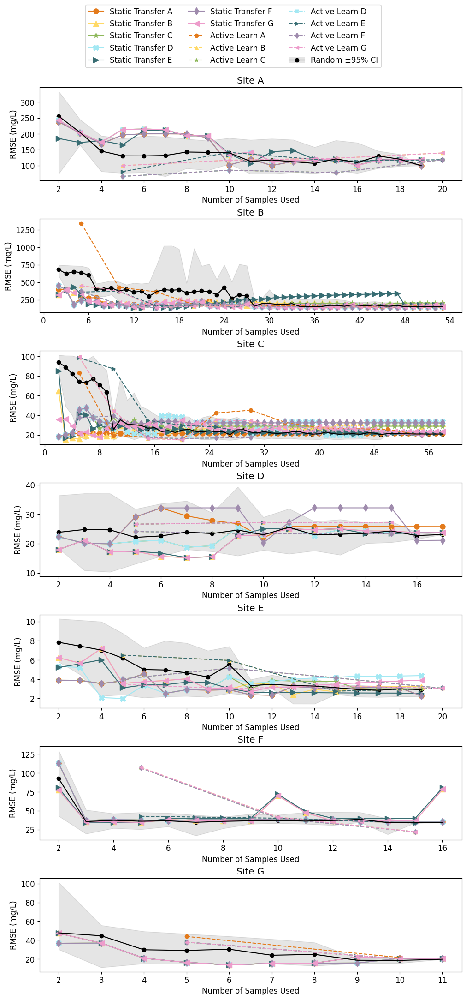

In [50]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
from matplotlib.legend_handler import HandlerTuple

fig, axes = plt.subplots(7, 1, figsize=(10, 20), constrained_layout=True)

# To store legend handles/labels just once
legend_handles = []
legend_labels = []

for idx, site_id in enumerate(adaptive_learning.keys()):
    if idx >= len(axes):
        break

    ax = axes[idx]

    # === Plot OMP ===
    for i, model_id in enumerate(alpha_site_id):
        print(optimal_dictionary[site_id][model_id].keys())
        if model_id not in optimal_dictionary[site_id]:
            continue

        sample_counts = sorted(optimal_dictionary[site_id][model_id].keys())
        rmse_values = [
            optimal_dictionary[site_id][model_id][n]['scores']['rmse']
            for n in sample_counts
        ]

        line, = ax.plot(sample_counts, rmse_values, linestyle='-', color=colr_sc[i],
                label=f'OMP {model_id}', marker=markers[i+1], markersize=8)
        if idx == 0:  # Only collect handles from the first subplot
            legend_handles.append(line)
            legend_labels.append(f'Static Transfer {model_id}')

    # === Plot Adaptive Learning ===
    if site_id in adaptive_learning:
        for i, model_id in enumerate(alpha_site_id):
            if model_id not in adaptive_learning[site_id]:
                continue

            al_rmse = []
            al_counts = []

            for n in sorted(adaptive_learning[site_id][model_id].keys()):
                entry = adaptive_learning[site_id][model_id][n]
                if 'scores' in entry:
                    al_rmse.append(entry['scores']['rmse'])
                    al_counts.append(n)

            if al_rmse:
                line, = ax.plot(al_counts, al_rmse, linestyle='--', color=colr_sc[i],
                                label=f'Active Learn {model_id}', marker=markers[i+1], markersize=6)
                if idx == 0:  # Only collect handles from the first subplot
                    legend_handles.append(line)
                    legend_labels.append(f'Active Learn {model_id}')

# === Plot Random Sampling ===
for idx, site_id in enumerate(random_dictionary.keys()):
    if idx >= len(axes):
        break

    ax = axes[idx]

    sample_sizes = []
    rmse_means = []
    rmse_mins = []
    rmse_maxs = []

    for n in random_dictionary[site_id].keys():
        if isinstance(n, np.int64):
            sample_sizes.append(n)
            rmse_means.append(random_dictionary[site_id][n]['rmse_mean'])
            rmse_mins.append(random_dictionary[site_id][n]['rmse_best'][0])
            rmse_maxs.append(random_dictionary[site_id][n]['rmse_worst'][0])

    line = ax.plot(sample_sizes, rmse_means, color='black', label=f'Random {site_id}')[0]
    ax.scatter(sample_sizes, rmse_means, color='black',label=f'Random {site_id}' )
    ax.fill_between(sample_sizes, rmse_mins, rmse_maxs, color='black', alpha=0.1, label="Random ±95% CI")
    

    if idx == 0:
        # Create custom legend entry: line with marker + shaded patch
        legend_line = Line2D([], [], color='black', linestyle='-', marker='o', markersize=6)
        legend_patch = Patch(facecolor='black', edgecolor='none', alpha=0.1)
        legend_handles.append((legend_line, legend_patch))
        legend_labels.append("Random ±95% CI")

    ax.set_xlabel('Number of Samples Used')
    ax.set_ylabel('RMSE (mg/L)')
    ax.set_title(f'Site {site_id}')
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))

# Hide unused subplots
for i in range(len(adaptive_learning), len(axes)):
    fig.delaxes(axes[i])

# Add shared legend above all plots
fig.legend(
    legend_handles,
    legend_labels,
    loc='upper center',
    ncol=3,  # or adjust to your preferred number of columns
    fontsize='medium',
    bbox_to_anchor=(0.5, 1.08)  # adjust vertical spacing if needed
)

# ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=3)
# plt.show()


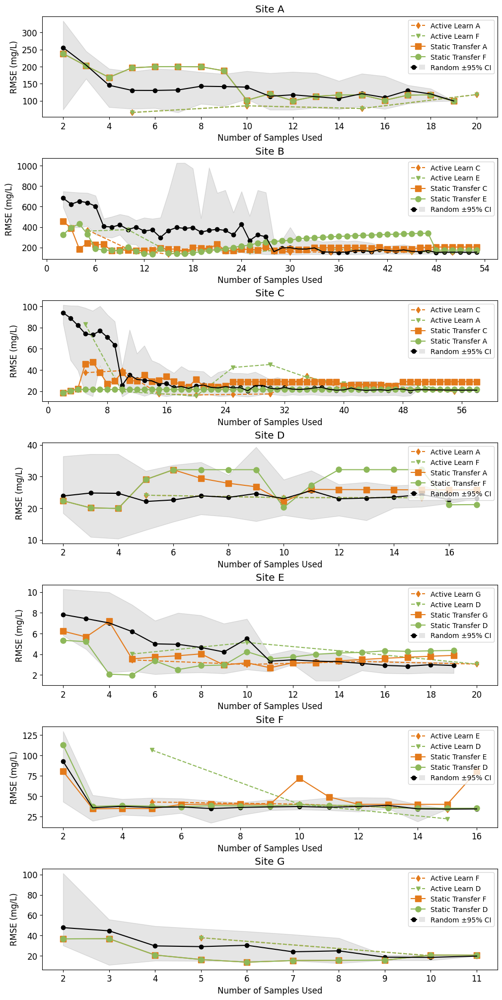

In [64]:
fig, axes = plt.subplots(len(adaptive_learning), 1, figsize=(10, 20), constrained_layout=True)

for idx, site_id in enumerate(adaptive_learning.keys()):
    if idx >= len(axes):
        break
    ax = axes[idx]

    # --- Step 1: Collect RMSE summary for each model_id in adaptive_learning ---
    model_rmse_summary = {}
    for model_id in alpha_site_id:
        if model_id not in adaptive_learning[site_id]:
            continue
        rmses = []
        for n in adaptive_learning[site_id][model_id].keys():
            entry = adaptive_learning[site_id][model_id][n]
            if 'scores' in entry and 'rmse' in entry['scores']:
                rmses.append(entry['scores']['rmse'])
        if rmses:
            model_rmse_summary[model_id] = np.mean(rmses)
        else:
            model_rmse_summary[model_id] = np.inf  # treat no data as worst

    # --- Step 2: Sort model_ids by RMSE ---
    sorted_models = sorted(model_rmse_summary.items(), key=lambda x: x[1])
    num_models = len(sorted_models)

    # Pick best, median, worst
    if num_models == 0:
        selected_models = []
    elif num_models < 2:
        selected_models = [m[0] for m in sorted_models]
    else:
        selected_models = [
            sorted_models[0][0],               # best
            sorted_models[num_models // 2][0],# median
            # sorted_models[-1][0],              # worst
        ]

    legend_handles = []
    legend_labels = []

    # --- Step 3: Plot adaptive learning only for selected models ---
    for i, model_id in enumerate(selected_models):
        al_rmse = []
        al_counts = []

        for n in sorted(adaptive_learning[site_id][model_id].keys()):
            entry = adaptive_learning[site_id][model_id][n]
            if 'scores' in entry and 'rmse' in entry['scores']:
                al_rmse.append(entry['scores']['rmse'])
                al_counts.append(n)

        if al_rmse:
            line, = ax.plot(al_counts, al_rmse, linestyle='--', color=colr_sc[2*i],
                            label=f'Active Learn {model_id}', marker=markers[2*(i+3)], markersize=6)
            legend_handles.append(line)
            legend_labels.append(f'Active Learn {model_id}')

    # --- Step 4: Plot OMP results only for the same selected models ---
    for i, model_id in enumerate(selected_models):
        if model_id not in optimal_dictionary.get(site_id, {}):
            continue

        sample_counts = sorted(optimal_dictionary[site_id][model_id].keys())
        rmse_values = []
        for n in sample_counts:
            if 'scores' in optimal_dictionary[site_id][model_id][n] and 'rmse' in optimal_dictionary[site_id][model_id][n]['scores']:
                rmse_values.append(optimal_dictionary[site_id][model_id][n]['scores']['rmse'])

        if rmse_values:
            line, = ax.plot(sample_counts, rmse_values, linestyle='-', color=colr_sc[2*i],
                            label=f'Static Transfer {model_id}', marker=markers[i], markersize=8)
            legend_handles.append(line)
            legend_labels.append(f'Static Transfer {model_id}')

    # --- Step 5: Plot Random Sampling for this site ---
    if site_id in random_dictionary:
        sample_sizes = []
        rmse_means = []
        rmse_mins = []
        rmse_maxs = []

        for n in random_dictionary[site_id].keys():
            if isinstance(n, (int, np.integer)):
                sample_sizes.append(n)
                rmse_means.append(random_dictionary[site_id][n]['rmse_mean'])
                rmse_mins.append(random_dictionary[site_id][n]['rmse_best'][0])
                rmse_maxs.append(random_dictionary[site_id][n]['rmse_worst'][0])

        if sample_sizes:
            line = ax.plot(sample_sizes, rmse_means, color='black', label=f'Random {site_id}')[0]
            ax.scatter(sample_sizes, rmse_means, color='black')
            ax.fill_between(sample_sizes, rmse_mins, rmse_maxs, color='black', alpha=0.1)

            # Add Random to legend
            line_with_marker = Line2D(
                [], [], color='black', marker='o', linestyle='-', markersize=6,
                label='Random ±95% CI'
            )
            fill_patch = Patch(facecolor='black', edgecolor='none', alpha=0.1)
            legend_handles.append((line_with_marker, fill_patch))
            legend_labels.append('Random ±95% CI')

    ax.set_xlabel('Number of Samples Used')
    ax.set_ylabel('RMSE (mg/L)')
    ax.set_title(f'Site {site_id}')
    ax.xaxis.set_major_locator(ticker.MaxNLocator(integer=True))

    # Add legend for this subplot, handle tuple for Random ±95% CI
    ax.legend(
        legend_handles,
        legend_labels,
        handler_map={tuple: HandlerTuple(ndivide=None)},
        loc='upper right',
        fontsize='small'
    )

plt.show()
